# Practical Application III: Comparing Classifiers

**Overview**: In this practical application, your goal is to compare the performance of the classifiers we encountered in this section, namely K Nearest Neighbor, Logistic Regression, Decision Trees, and Support Vector Machines.  We will utilize a dataset related to marketing bank products over the telephone.  



### Getting Started

Our dataset comes from the UCI Machine Learning repository [link](https://archive.ics.uci.edu/ml/datasets/bank+marketing).  The data is from a Portugese banking institution and is a collection of the results of multiple marketing campaigns.  We will make use of the article accompanying the dataset [here](CRISP-DM-BANK.pdf) for more information on the data and features.



### Problem 1: Understanding the Data

To gain a better understanding of the data, please read the information provided in the UCI link above, and examine the **Materials and Methods** section of the paper.  How many marketing campaigns does this data represent?

<span style='color:red;font-size: 150%'> Business Understanding </span>

In this practical application, we are trying to compare the performance of different machine learning classifiers for a marketing campaign for a bank's products over the telephone. The goal is to identify the classifier that can best predict customer response to the marketing campaign and maximize its effectiveness. The dataset used for this purpose contains information about customer demographics, banking history, and other relevant features. By evaluating the performance of different classifiers using various evaluation metrics, we aim to find the most suitable classifier to predict customer response, and ultimately increase the success rate of the marketing campaign and improve the bank's revenue.

<span style='color:red;font-size: 150%'> Data Understanding </span>

It contains information collected from a Portuguese retail bank regarding direct marketing campaigns. The dataset includes 41,188 observations, with 20 input variables and 1 output variable. The input variables include information about the customer such as age, job, marital status, education, and previous contact information. The output variable is whether or not the customer subscribed to a term deposit. The data is related to direct marketing campaigns of a Portuguese banking institution. The classification goal is to predict if the client will subscribe a term deposit (variable y)

None of the columns contain "NaN" values. Duplicates were not observed. It is thought that in order to provide more insight into the aforementioned dataset, a data preparation,i.e, data cleaning process needs to be done first.


In [127]:
!pip install imblearn
!pip install plot-metric
!pip install scikit-plot

### Problem 2: Read in the Data

Use pandas to read in the dataset `bank-additional-full.csv` and assign to a meaningful variable name.

In [128]:
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.tree import DecisionTreeClassifier, export_text, plot_tree
from sklearn.metrics import confusion_matrix,classification_report,plot_confusion_matrix
from sklearn.metrics import RocCurveDisplay
from sklearn.metrics import precision_recall_curve
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import PrecisionRecallDisplay
import time
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from imblearn.over_sampling import SMOTE
from sklearn.metrics import log_loss, make_scorer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import roc_auc_score
from sklearn import metrics
from sklearn.dummy import DummyClassifier
import matplotlib.pyplot as plt
import scikitplot as skplt
from sklearn.model_selection import cross_validate
from sklearn.model_selection import RepeatedKFold
from plot_metric.functions import BinaryClassification
from sklearn.metrics import plot_roc_curve
from sklearn.metrics import roc_curve, auc, roc_auc_score
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.preprocessing import MinMaxScaler 
from sklearn import tree
from sklearn.tree import export_graphviz
from sklearn.inspection import permutation_importance
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV

In [60]:
df = pd.read_csv('data/bank-additional-full.csv', sep = ';')

In [61]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

### Problem 3: Understanding the Features


Examine the data description below, and determine if any of the features are missing values or need to be coerced to a different data type.


```
Input variables:
# bank client data:
1 - age (numeric)
2 - job : type of job (categorical: 'admin.','blue-collar','entrepreneur','housemaid','management','retired','self-employed','services','student','technician','unemployed','unknown')
3 - marital : marital status (categorical: 'divorced','married','single','unknown'; note: 'divorced' means divorced or widowed)
4 - education (categorical: 'basic.4y','basic.6y','basic.9y','high.school','illiterate','professional.course','university.degree','unknown')
5 - default: has credit in default? (categorical: 'no','yes','unknown')
6 - housing: has housing loan? (categorical: 'no','yes','unknown')
7 - loan: has personal loan? (categorical: 'no','yes','unknown')
# related with the last contact of the current campaign:
8 - contact: contact communication type (categorical: 'cellular','telephone')
9 - month: last contact month of year (categorical: 'jan', 'feb', 'mar', ..., 'nov', 'dec')
10 - day_of_week: last contact day of the week (categorical: 'mon','tue','wed','thu','fri')
11 - duration: last contact duration, in seconds (numeric). Important note: this attribute highly affects the output target (e.g., if duration=0 then y='no'). Yet, the duration is not known before a call is performed. Also, after the end of the call y is obviously known. Thus, this input should only be included for benchmark purposes and should be discarded if the intention is to have a realistic predictive model.
# other attributes:
12 - campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)
13 - pdays: number of days that passed by after the client was last contacted from a previous campaign (numeric; 999 means client was not previously contacted)
14 - previous: number of contacts performed before this campaign and for this client (numeric)
15 - poutcome: outcome of the previous marketing campaign (categorical: 'failure','nonexistent','success')
# social and economic context attributes
16 - emp.var.rate: employment variation rate - quarterly indicator (numeric)
17 - cons.price.idx: consumer price index - monthly indicator (numeric)
18 - cons.conf.idx: consumer confidence index - monthly indicator (numeric)
19 - euribor3m: euribor 3 month rate - daily indicator (numeric)
20 - nr.employed: number of employees - quarterly indicator (numeric)

Output variable (desired target):
21 - y - has the client subscribed a term deposit? (binary: 'yes','no')
```



In [62]:
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [ ]:
# checking for duplicates.

In [63]:
df.duplicated().sum()

12

In [64]:
# there are 12 duplicates and will be dropped below
df.drop_duplicates(inplace=True)

In [ ]:
# Check Target Variable Y

In [65]:
df['y'].value_counts(normalize=True)

no     0.887337
yes    0.112663
Name: y, dtype: float64

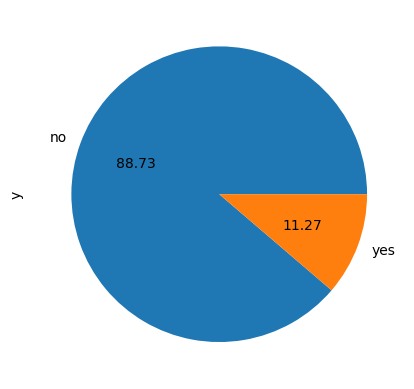

In [66]:
df['y'].value_counts().plot.pie(autopct="%.2f");

In [71]:
Y_categories={'yes':1,'no': 0}                                        
df['y_category']=df['y'].map(Y_categories)

## Visualization of Categorical Data

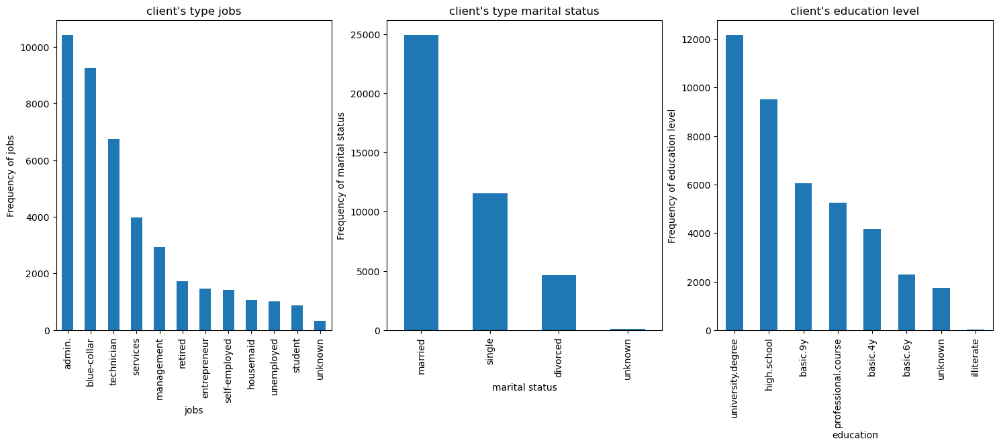

In [58]:
plt.figure(figsize=(18, 6))

plt.subplot(1,3,1)
plt1 = df.job.value_counts().plot(kind='bar')
plt.title("client's type jobs")
plt1.set(xlabel = 'jobs', ylabel='Frequency of jobs')

plt.subplot(1,3,2)
plt1 = df.marital.value_counts().plot(kind='bar')
plt.title("client's type marital status")
plt1.set(xlabel = 'marital status', ylabel='Frequency of marital status')

plt.subplot(1,3,3)
plt1 = df.education.value_counts().plot(kind='bar')
plt.title("client's education level")
plt1.set(xlabel = 'education', ylabel='Frequency of education level')


plt.show()

### Problem 4: Understanding the Task

After examining the description and data, your goal now is to clearly state the *Business Objective* of the task.  State the objective below.

The dataset used for this purpose contains information about customer demographics, banking history, and other relevant features. By evaluating the performance of different classifiers using various evaluation metrics, we aim to find the most suitable classifier to predict customer response, and ultimately increase the success rate of the marketing campaign and improve the bank's revenue.

### Problem 5: Engineering Features

Now that you understand your business objective, we will build a basic model to get started.  Before we can do this, we must work to encode the data.  Using just the bank information features (columns 1 - 7), prepare the features and target column for modeling with appropriate encoding and transformations.

In [67]:
df.columns[:7]

Index(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan'], dtype='object')

In [25]:
# Understanding the numerical column Age

In [68]:
df['age'].describe()

count    41176.00000
mean        40.02380
std         10.42068
min         17.00000
25%         32.00000
50%         38.00000
75%         47.00000
max         98.00000
Name: age, dtype: float64

In [69]:
bins = [-np.inf,20,40,60,80,np.inf]
labels = ['age_less_than_20_years' ,'age_>=20_and_<40_years','age_>=40 &_<60_years', 'age_>=60_and_<80 years',\
          'age_above_100_years']
df['age_bins'] = pd.cut(df.age, bins=bins,labels=labels,  right=False, include_lowest=True)

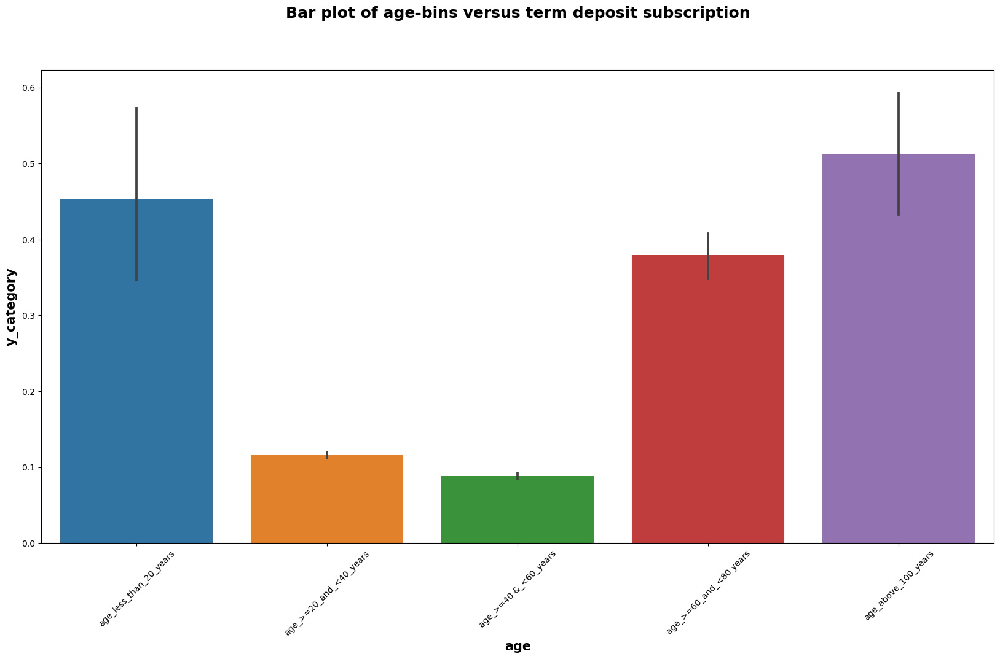

In [72]:
plt.figure(figsize=(20,10))
sns.barplot(x='age_bins',y='y_category',data=df)
plt.xticks(rotation=45)
plt.xlabel('age', fontweight='bold',fontsize=15)
plt.ylabel('y_category', fontweight='bold',fontsize=15)
plt.title("Bar plot of age-bins versus term deposit subscription",fontweight="bold",fontsize=18,y=1.1);

In [73]:
feature=['job', 'marital', 'education', 'default', 'housing', 'loan']

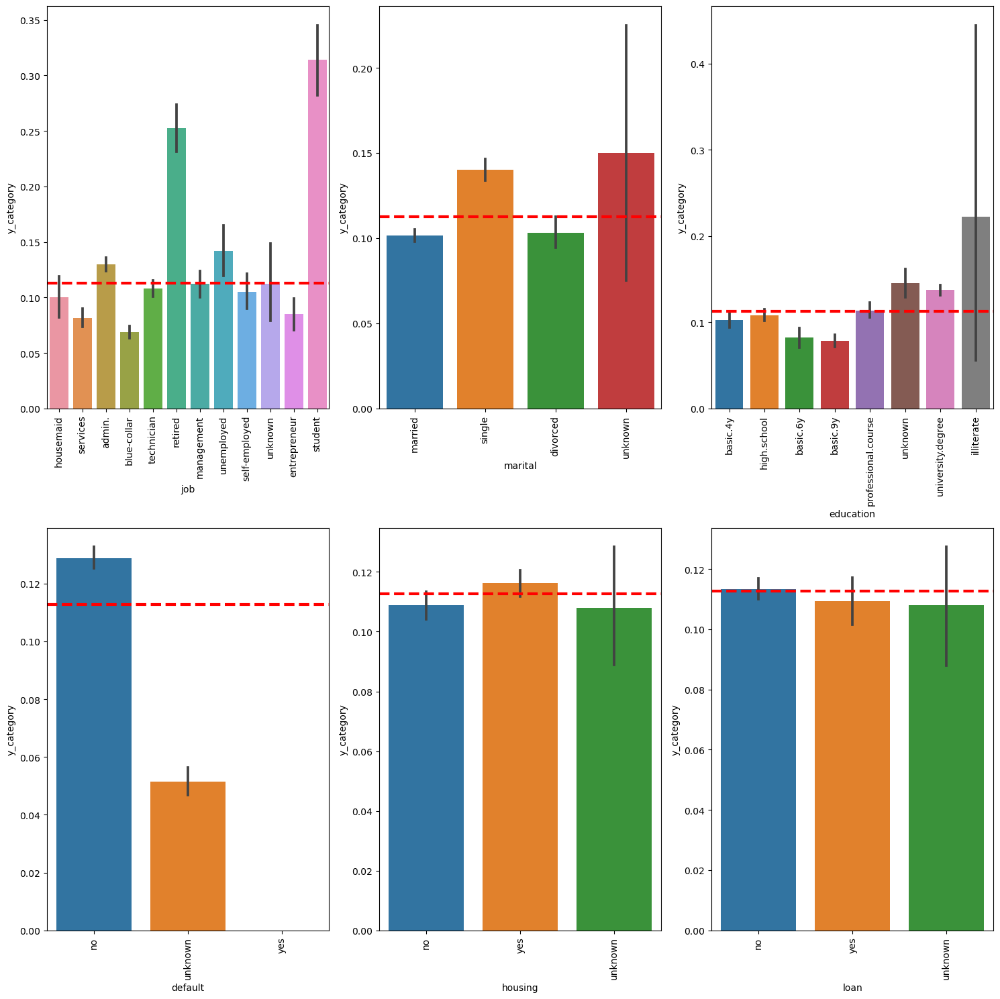

In [74]:
plt.figure(figsize=(15,15))
for i in enumerate(feature):
        plt.subplot(2,3,i[0]+1)
        #plt.ylim(7500,28000)
        fig=sns.barplot(x=i[1],y=df['y_category'],data=df[['job', 'marital', 'education', 'default', 'housing', 'loan','y_category']])
        plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
        plt.xticks(rotation=90)
        plt.tight_layout(h_pad=1)
       

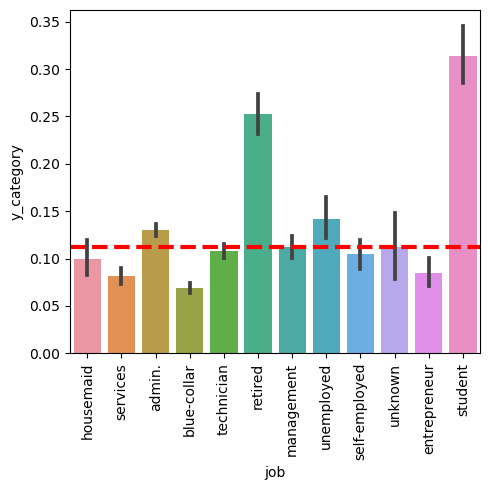

In [75]:
plt.figure(figsize=(5,5))
fig=sns.barplot(x=df['job'],y=df['y_category'],data=df)
plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
plt.xticks(rotation=90)
plt.tight_layout(h_pad=1)

In [76]:
# Grouping Job# categories

In [77]:
df['job'].unique()

array(['housemaid', 'services', 'admin.', 'blue-collar', 'technician',
       'retired', 'management', 'unemployed', 'self-employed', 'unknown',
       'entrepreneur', 'student'], dtype=object)

In [78]:
job_categories={'housemaid':'job_rest',\
                       'services':'job_rest',
                      'admin.':'job_admin_retired_unemployed_student', \
                      'blue-collar':'job_rest',\
                      'technician':'job_rest',\
                      'retired':'job_admin_retired_unemployed_student',\
                      'management':'job_rest',\
                       'unemployed':'job_admin_retired_unemployed_student',
                        'self-employed':'job_rest',
                        'unknown':'job_rest',
                      'entrepreneur':'job_rest',
                      'student':'job_admin_retired_unemployed_student'  }

In [79]:
df['job_category']=df['job'].map(job_categories)

In [80]:
df.job_category.value_counts()

job_rest                                27150
job_admin_retired_unemployed_student    14026
Name: job_category, dtype: int64

In [81]:
##### Reducing the 'Marital' column categories

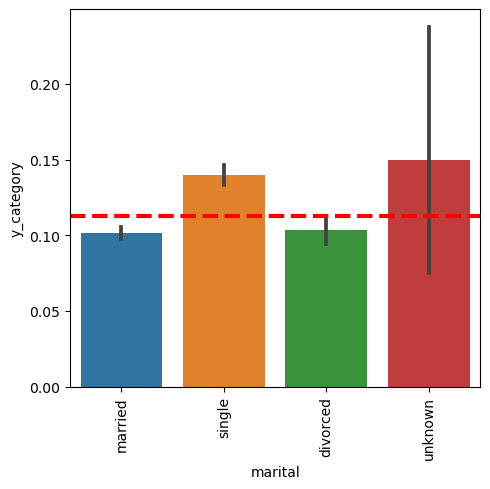

In [82]:
plt.figure(figsize=(5,5))
fig=sns.barplot(x=df['marital'],y=df['y_category'],data=df)
plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
plt.xticks(rotation=90)
plt.tight_layout(h_pad=1)

In [83]:
df['marital'].unique()

array(['married', 'single', 'divorced', 'unknown'], dtype=object)

In [84]:
marital_categories={'married':'marital_rest',\
                       'single':'marital_single_unknown',
                      'divorced':'marital_rest', \
                      'unknown':'marital_single_unknown'    }

In [85]:
df['marital_category']=df['marital'].map(marital_categories)

In [86]:
df.marital_category.value_counts()

marital_rest              29532
marital_single_unknown    11644
Name: marital_category, dtype: int64

In [87]:
#Reducing the 'education' column categories

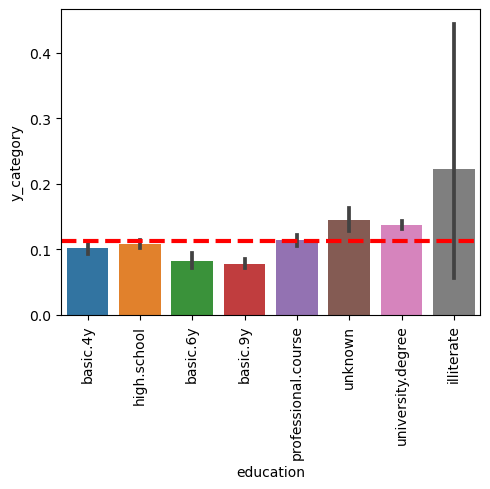

In [88]:
plt.figure(figsize=(5,5))
fig=sns.barplot(x=df['education'],y=df['y_category'],data=df)
plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
plt.xticks(rotation=90)
plt.tight_layout(h_pad=1)

In [89]:
df['education'].unique()

array(['basic.4y', 'high.school', 'basic.6y', 'basic.9y',
       'professional.course', 'unknown', 'university.degree',
       'illiterate'], dtype=object)

In [90]:
df.groupby('education')['y_category'].mean()

education
basic.4y               0.102490
basic.6y               0.082060
basic.9y               0.078246
high.school            0.108389
illiterate             0.222222
professional.course    0.113550
university.degree      0.137208
unknown                0.145087
Name: y_category, dtype: float64

In [91]:
education_categories={'basic.4y':'education_rest',\
                       'high.school':'education_rest',
                      'basic.6y':'education_rest', \
                      'basic.9y':'education_rest',  
                    'professional.course':'education_rest',
                    'unknown':'education_unknown_university.degree_illiterate',
                    'university.degree':'education_unknown_university.degree_illiterate',
                    'illiterate':'education_unknown_university.degree_illiterate'                
}

In [92]:
df['education_category']=df['education'].map(education_categories)

In [93]:
df.education_category.value_counts()

education_rest                                    27264
education_unknown_university.degree_illiterate    13912
Name: education_category, dtype: int64

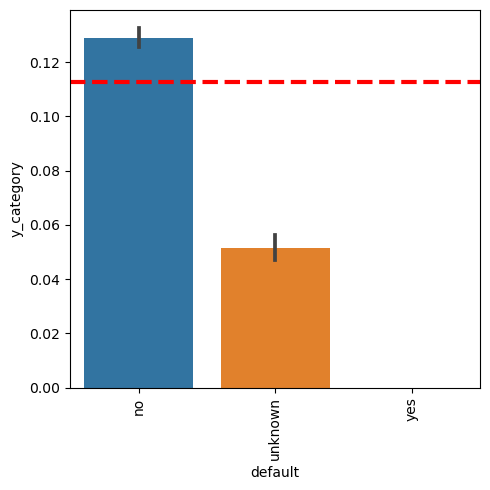

In [94]:
plt.figure(figsize=(5,5))
fig=sns.barplot(x=df['default'],y=df['y_category'],data=df)
plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
plt.xticks(rotation=90)
plt.tight_layout(h_pad=1)

In [95]:
df['default'].unique()

array(['no', 'unknown', 'yes'], dtype=object)

In [96]:
df.groupby('default')['y_category'].mean()

default
no         0.128803
unknown    0.051536
yes        0.000000
Name: y_category, dtype: float64

In [97]:
default_categories={'no':'default_no',\
                       'unknown':'default_rest',
                      'yes':'default_rest'                               
}

In [98]:
df['default_category']=df['default'].map(default_categories)

In [99]:
df.default_category.value_counts()

default_no      32577
default_rest     8599
Name: default_category, dtype: int64

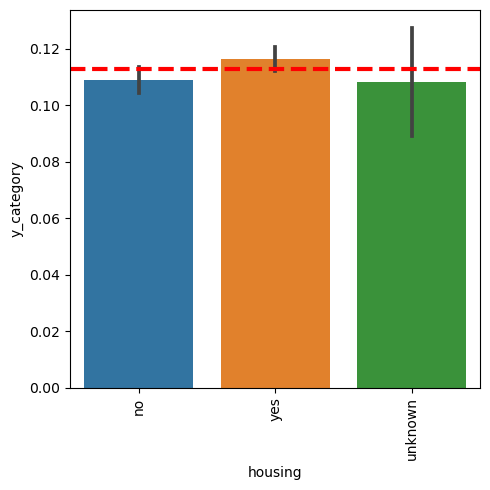

In [100]:
plt.figure(figsize=(5,5))
fig=sns.barplot(x=df['housing'],y=df['y_category'],data=df)
plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
plt.xticks(rotation=90)
plt.tight_layout(h_pad=1)

In [101]:
df['housing'].unique()

array(['no', 'yes', 'unknown'], dtype=object)

In [102]:
df.groupby('housing')['y_category'].mean()

housing
no         0.108783
unknown    0.108081
yes        0.116221
Name: y_category, dtype: float64

In [103]:
housing_categories={'yes':'housing_yes',\
                       'no':'housing_rest',
                      'unknown':'housing_rest'                               
}

In [104]:
df['housing_category']=df['housing'].map(housing_categories)

In [105]:
df.housing_category.value_counts()

housing_yes     21571
housing_rest    19605
Name: housing_category, dtype: int64

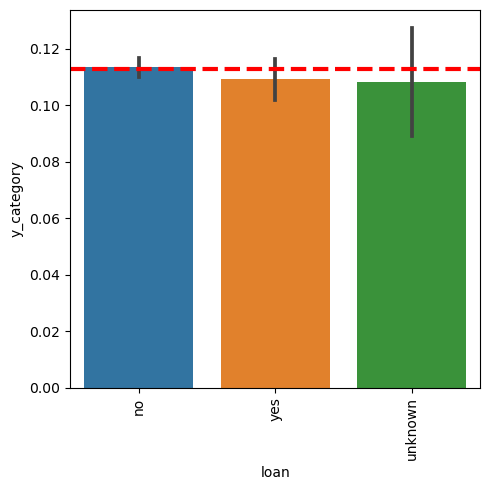

In [106]:
plt.figure(figsize=(5,5))
fig=sns.barplot(x=df['loan'],y=df['y_category'],data=df)
plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
plt.xticks(rotation=90)
plt.tight_layout(h_pad=1)

In [107]:
df['loan'].unique()

array(['no', 'yes', 'unknown'], dtype=object)

In [108]:
df.groupby('loan')['y_category'].mean()

loan
no         0.113413
unknown    0.108081
yes        0.109315
Name: y_category, dtype: float64

In [109]:
loan_categories={'no':'loan_no',\
                       'unknown':'loan_rest',
                      'yes':'loan_rest'                               
}

In [110]:
df['loan_category']=df['loan'].map(loan_categories)

In [111]:
df.loan_category.value_counts()

loan_no      33938
loan_rest     7238
Name: loan_category, dtype: int64

In [ ]:
#Create a new dataframe with first 7 columns

In [112]:
modifieddf=df[['age','job_category','marital_category','education_category','default_category','housing_category',\
       'loan_category','y_category']]

In [113]:
dfa=modifieddf.copy(deep=True)

### Problem 6: Train/Test Split

With your data prepared, split it into a train and test set.

In [116]:
X1 = modifieddf.drop('y_category',axis=1)
y1 = modifieddf['y_category']

In [117]:
X_train, X_test, y_train, y_test = train_test_split(X1, y1, test_size=0.3, random_state=101,stratify=y1)

In [129]:
categorical_features = ['job_category', 'marital_category', 'education_category',
       'default_category', 'housing_category', 'loan_category']
numerical_features = ['age']

numeric_transformer = Pipeline(
    steps=[
        ("scaler", MinMaxScaler())]
)

categorical_transformer = OneHotEncoder(drop="if_binary")


preprocessor_minmax = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numerical_features),
        ("cat", categorical_transformer, categorical_features)
    ])

### Problem 7: A Baseline Model

Before we build our first model, we want to establish a baseline.  What is the baseline performance that our classifier should aim to beat?

In [130]:
# establish baseline for the models 

In [131]:
Baseline_model= Pipeline([("preprocessor", preprocessor_minmax), ('Baseline',MultinomialNB())])

In [132]:
Baseline_model_start = time.time()
Baseline_model.fit(X_train, y_train)
Baseline_model_end = time.time()
Baseline_model_train_time=Baseline_model_end-Baseline_model_start
Baseline_model_train_time

0.05984759330749512

In [133]:
#Train accuracy for Naive bayes Model

In [135]:
Baseline_model_train_accuracy=roc_auc_score(y_train,Baseline_model.predict_proba(X_train)[:, 1])
Baseline_model_train_accuracy

0.6270481719898515

In [ ]:
#Test accuracy for Naive bayes Model

In [136]:
Baseline_model_test_accuracy=roc_auc_score(y_test,Baseline_model.predict_proba(X_test)[:, 1])
Baseline_model_test_accuracy

0.622309819453926

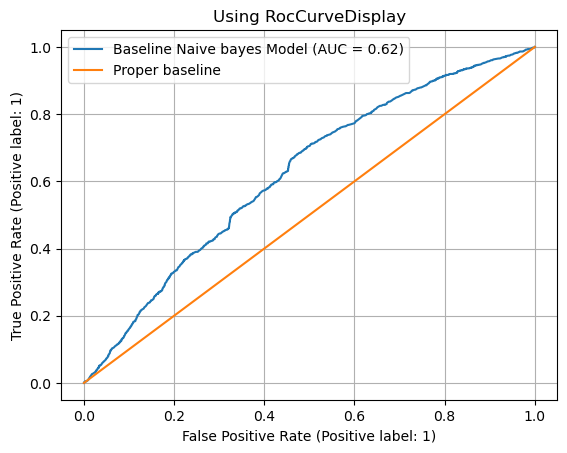

In [138]:
fig, ax = plt.subplots()
plot_roc_curve(Baseline_model, X_test, y_test,ax = ax, name = 'Baseline Naive bayes Model')
plt.grid()
plt.plot(np.arange(0, 1.1, .1), np.arange(0, 1.1, .1), label = 'Proper baseline');
plt.title('Using RocCurveDisplay')
plt.legend();

In [139]:
print(classification_report(y_test,Baseline_model.predict(X_test)))

              precision    recall  f1-score   support

           0       0.89      1.00      0.94     10961
           1       0.00      0.00      0.00      1392

    accuracy                           0.89     12353
   macro avg       0.44      0.50      0.47     12353
weighted avg       0.79      0.89      0.83     12353



### Problem 8: A Simple Model

Use Logistic Regression to build a basic model on your data.  

In [140]:
categorical_features = ['job_category', 'marital_category', 'education_category',
       'default_category', 'housing_category', 'loan_category']
numerical_features = ['age']

numeric_transformer = Pipeline(
    steps=[
      ("scaler", StandardScaler())]
)

categorical_transformer = OneHotEncoder(drop="if_binary")



preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numerical_features),
        ("cat", categorical_transformer, categorical_features)
    ])

In [141]:
# creating pipeline

In [142]:
Log_default= Pipeline([("preprocessor", preprocessor), ('Log',LogisticRegression())])

In [143]:
# fittingthe model

In [149]:
Log_default_start= time.time()
Log_default.fit(X_train,y_train)
Log_default_end= time.time()
Log_default_train_time=Log_default_end-Log_default_start
Log_default_train_time

0.0727224349975586

### Problem 9: Score the Model

What is the accuracy of your model?

In [150]:
Log_default_train_accuracy=roc_auc_score(y_train,Log_default.predict_proba(X_train)[:, 1])

Log_default_train_accuracy

0.6399127935904647

In [199]:
Log_default_test_accuracy=roc_auc_score(y_test,Log_default.predict_proba(X_test)[:, 1])

Log_default_test_accuracy

0.640396148518205

In [151]:
#test accuracy for logistic Regression model - using predictions

In [152]:
y_pred_Log_default = Log_default.predict(X_test)
fp_rate, tp_rate, thresholds = roc_curve(y_test, y_pred_Log_default)
metrics.auc(fp_rate, tp_rate)

0.5

In [153]:
# PLot -1: ROC curve-AUC to compare the models performance against baseline NB Model and absolute baseline

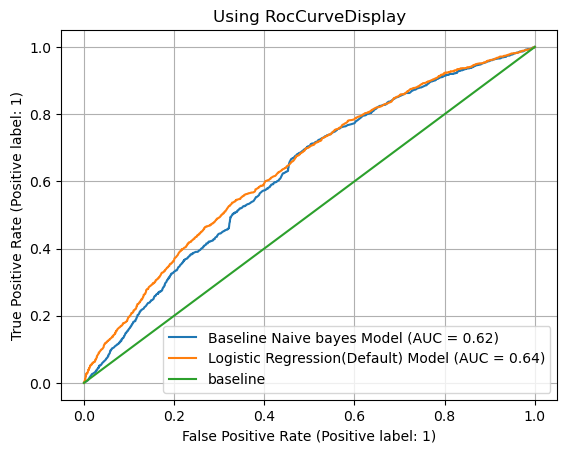

In [154]:
fig, ax = plt.subplots()
plot_roc_curve(Baseline_model, X_test, y_test,ax = ax, name = 'Baseline Naive bayes Model')
plot_roc_curve(Log_default, X_test, y_test,ax = ax, name = 'Logistic Regression(Default) Model')
plt.grid()
plt.plot(np.arange(0, 1.1, .1), np.arange(0, 1.1, .1), label = 'baseline');
plt.title('Using RocCurveDisplay')
plt.legend();

In [155]:
#Confusion Matrix- for test data

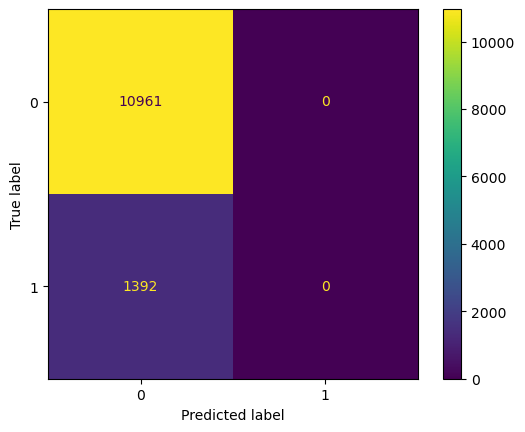

In [156]:
plot_confusion_matrix(Log_default,X_test,y_test)

In [159]:
##Classification report showing all major metrics

In [158]:
print(classification_report(y_test,Log_default.predict(X_test)))

              precision    recall  f1-score   support

           0       0.89      1.00      0.94     10961
           1       0.00      0.00      0.00      1392

    accuracy                           0.89     12353
   macro avg       0.44      0.50      0.47     12353
weighted avg       0.79      0.89      0.83     12353



In [160]:
#coefficeints outs to understand feature importance

In [161]:
feature_names = Log_default[:-1].get_feature_names_out()

coefs = pd.DataFrame(
   Log_default['Log'].coef_.T,
   columns=["Coefficients"],
    index=feature_names,
)

coefs

,Coefficients
num__age,0.205595
cat__job_category_job_rest,-0.426342
cat__marital_category_marital_single_unknown,0.432122
cat__education_category_education_unknown_university.degree_illiterate,0.186576
cat__default_category_default_rest,-0.968328
cat__housing_category_housing_yes,0.090953
cat__loan_category_loan_rest,-0.055392


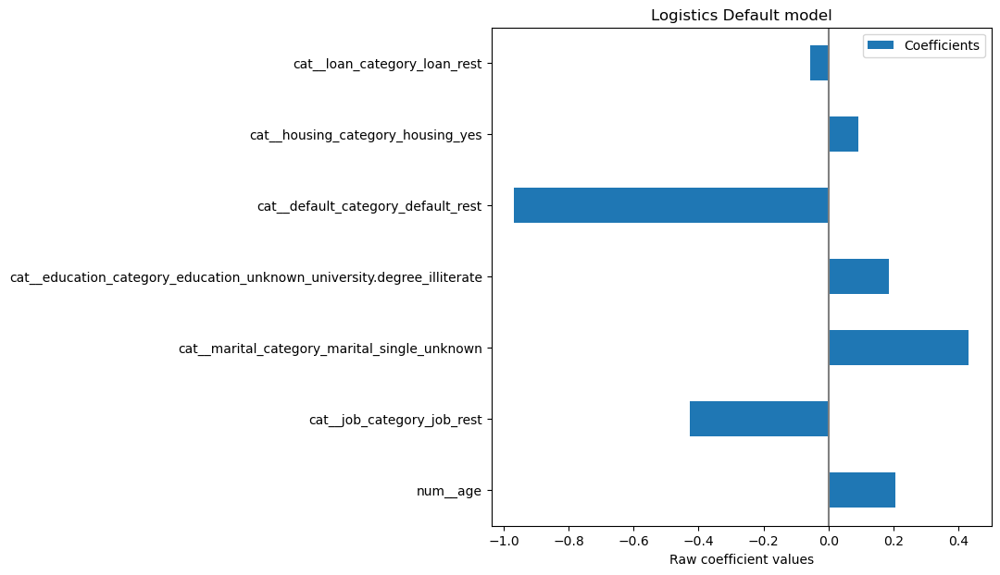

In [162]:
coefs.plot.barh(figsize=(9, 7))
plt.title("Logistics Default model")
plt.axvline(x=0, color=".5")
plt.xlabel("Raw coefficient values")
plt.subplots_adjust(left=0.3)

In [164]:
cv = RepeatedKFold(n_splits=5, n_repeats=5, random_state=0)
cv_model_log = cross_validate(
    Log_default,
    X_train,
    y_train,
    cv=cv,
    return_estimator=True,
    n_jobs=2,
)
coefs = pd.DataFrame(
    [est[-1].coef_[0] for est in cv_model_log["estimator"]], columns=Log_default[:-1].get_feature_names_out()
)

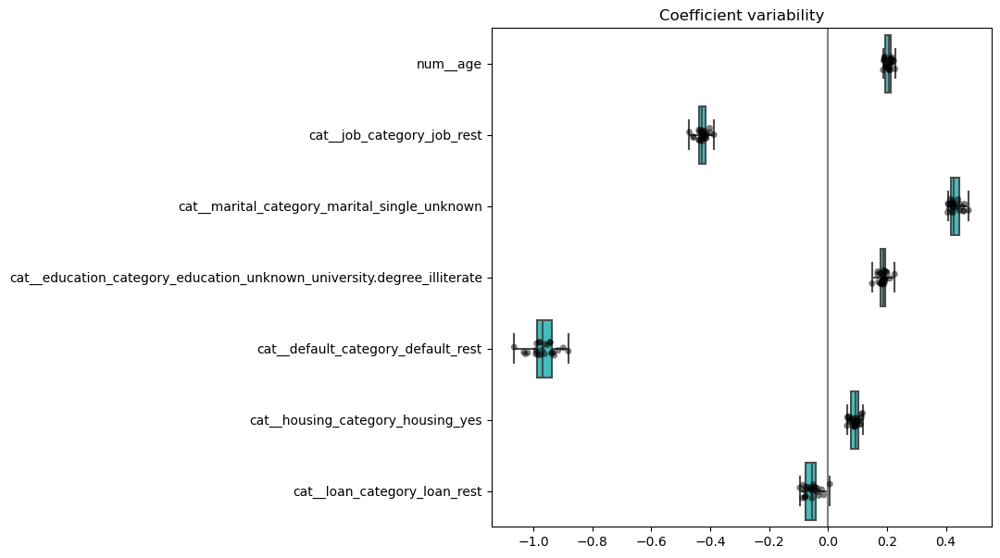

In [165]:
plt.figure(figsize=(9, 7))
sns.stripplot(data=coefs, orient="h", color="k", alpha=0.5)
sns.boxplot(data=coefs, orient="h", color="cyan", saturation=0.5, whis=10)
plt.axvline(x=0, color=".5")
plt.title("Coefficient variability")
plt.subplots_adjust(left=0.3)

In [166]:
# KNN Using default parameters

In [167]:
KNN_default= Pipeline([("preprocessor", preprocessor), ('KNN',KNeighborsClassifier())])

In [168]:
KNN_default_start= time.time()
KNN_default.fit(X_train,y_train)
KNN_default_end= time.time()
KNN_default_train_time=KNN_default_end-KNN_default_start
KNN_default_train_time

0.07724785804748535

In [ ]:
# Model Score

In [169]:
KNN_default_train_accuracy=roc_auc_score(y_train,KNN_default.predict_proba(X_train)[:, 1])

KNN_default_train_accuracy

0.6614310685863007

In [201]:
KNN_default_test_accuracy=roc_auc_score(y_test,KNN_default.predict_proba(X_test)[:, 1])

KNN_default_test_accuracy

0.5717035096743207

In [170]:
#compare the models performance against baseline NB Model and absolute baseline

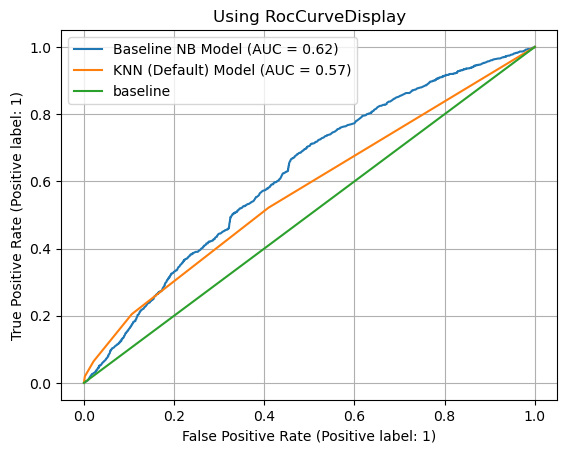

In [171]:
fig, ax = plt.subplots()
plot_roc_curve(Baseline_model, X_test, y_test,ax = ax, name = 'Baseline NB Model')
plot_roc_curve(KNN_default, X_test, y_test,ax = ax, name = 'KNN (Default) Model')
plt.grid()
plt.plot(np.arange(0, 1.1, .1), np.arange(0, 1.1, .1), label = 'baseline');
plt.title('Using RocCurveDisplay')
plt.legend();

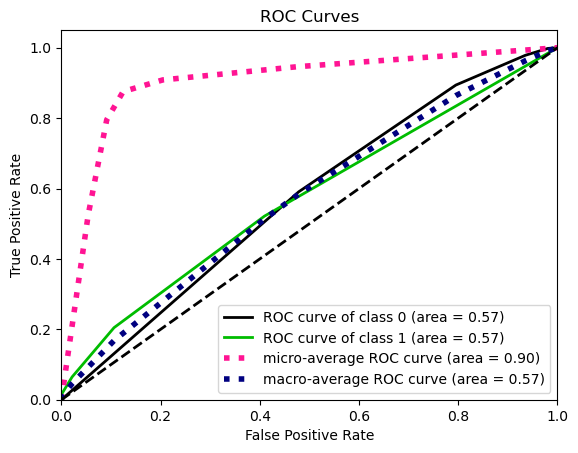

In [172]:
skplt.metrics.plot_roc_curve(y_test, KNN_default.predict_proba(X_test))
plt.show()

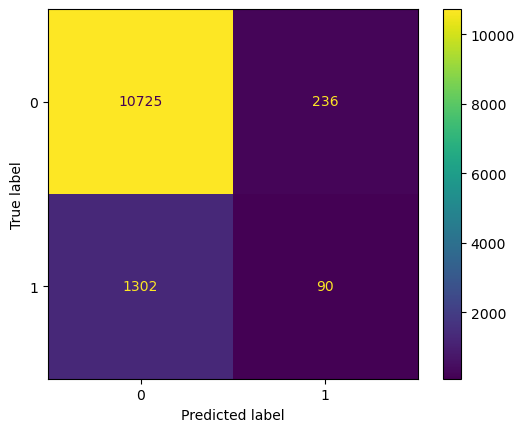

In [173]:
 plot_confusion_matrix(KNN_default,X_test,y_test);

In [174]:
print(classification_report(y_test,KNN_default.predict(X_test)))

              precision    recall  f1-score   support

           0       0.89      0.98      0.93     10961
           1       0.28      0.06      0.10      1392

    accuracy                           0.88     12353
   macro avg       0.58      0.52      0.52     12353
weighted avg       0.82      0.88      0.84     12353



In [175]:
#Decision Tree algorithm with its Default Parameters

In [177]:
categorical_features = ['job_category', 'marital_category', 'education_category',
       'default_category', 'housing_category', 'loan_category']
numerical_features = ['age']

numeric_transformer = Pipeline(
    steps=[
    #("imputer", SimpleImputer(strategy="median")),
    ("scaler", StandardScaler())
    ]
)

categorical_transformer = OneHotEncoder(drop="if_binary")



preprocessor_DT = ColumnTransformer(
    transformers=[
        #("num", numeric_transformer, numerical_features),
        ("cat", categorical_transformer, categorical_features)
    ])

In [178]:
DT_default= Pipeline([("preprocessor", preprocessor_DT), ('DT',DecisionTreeClassifier())])

In [179]:
DT_default_start= time.time()
DT_default.fit(X_train,y_train)
DT_default_end= time.time()
DT_default_train_time=DT_default_end-DT_default_start
DT_default_train_time

0.059417009353637695

In [180]:
DT_default_train_accuracy=roc_auc_score(y_train,DT_default.predict_proba(X_train)[:, 1])

DT_default_train_accuracy

0.636230344335557

In [181]:
DT_default_test_accuracy=roc_auc_score(y_test,DT_default.predict_proba(X_test)[:, 1])
DT_default_test_accuracy

0.6305602373409591

In [182]:
y_pred_DT_default = DT_default.predict(X_test)
fp_rate, tp_rate, thresholds = roc_curve(y_test, y_pred_DT_default)
metrics.auc(fp_rate, tp_rate)

0.5

In [183]:
#models performance against baseline NB Model and absolute baseline

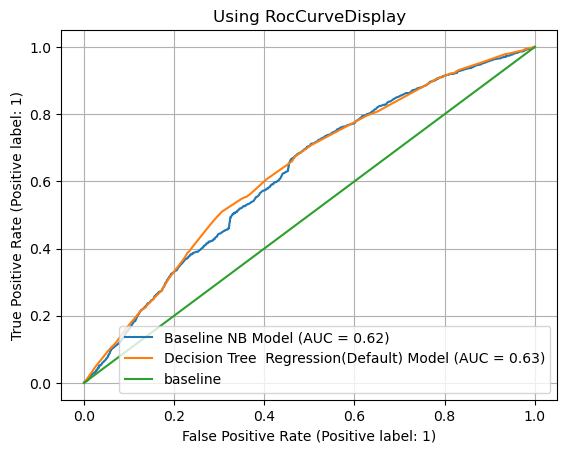

In [184]:
fig, ax = plt.subplots()
plot_roc_curve(Baseline_model, X_test, y_test,ax = ax, name = 'Baseline NB Model')
plot_roc_curve(DT_default, X_test, y_test,ax = ax, name = 'Decision Tree  Regression(Default) Model')
plt.grid()
plt.plot(np.arange(0, 1.1, .1), np.arange(0, 1.1, .1), label = 'baseline');
plt.title('Using RocCurveDisplay')
plt.legend();

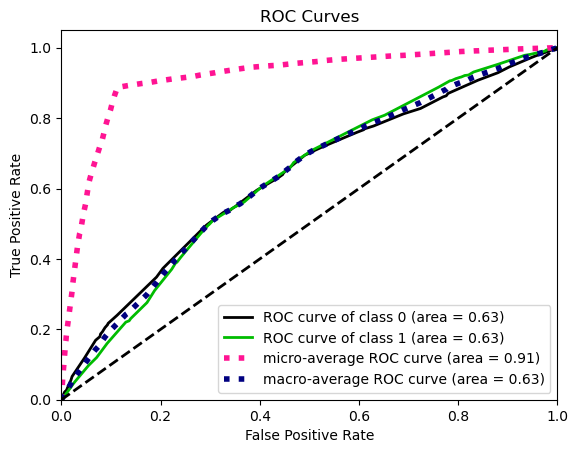

In [185]:
skplt.metrics.plot_roc_curve(y_test, DT_default.predict_proba(X_test))
plt.show()

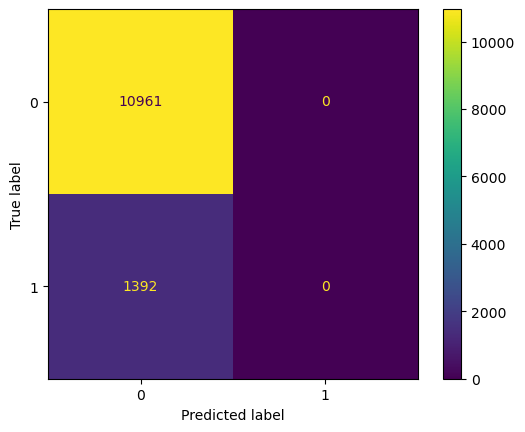

In [186]:
plot_confusion_matrix(DT_default,X_test,y_test);

In [187]:
print(classification_report(y_test,DT_default.predict(X_test)))

              precision    recall  f1-score   support

           0       0.89      1.00      0.94     10961
           1       0.00      0.00      0.00      1392

    accuracy                           0.89     12353
   macro avg       0.44      0.50      0.47     12353
weighted avg       0.79      0.89      0.83     12353



In [189]:
# SVM algorithm with its Default Parameters

In [190]:
SVM_default= Pipeline(
    steps=[("preprocessor", preprocessor), ('SVC',SVC(probability=True))]
)

In [191]:
SVM_default_start= time.time()
SVM_default.fit(X_train,y_train)
SVM_default_end= time.time()
SVM_default_train_time=SVM_default_end-SVM_default_start
SVM_default_train_time

115.96979427337646

In [192]:
SVM_default_train_accuracy=roc_auc_score(y_train,SVM_default.predict_proba(X_train)[:, 1])
SVM_default_train_accuracy

0.5611246116455612

In [203]:
SVM_default_test_accuracy=roc_auc_score(y_test,SVM_default.predict_proba(X_test)[:, 1])
SVM_default_test_accuracy

0.5431493922548807

In [193]:
y_pred_SVM_default = SVM_default.predict(X_test)
fp_rate, tp_rate, thresholds = roc_curve(y_test, y_pred_SVM_default)
metrics.auc(fp_rate, tp_rate)

0.5014766630802836

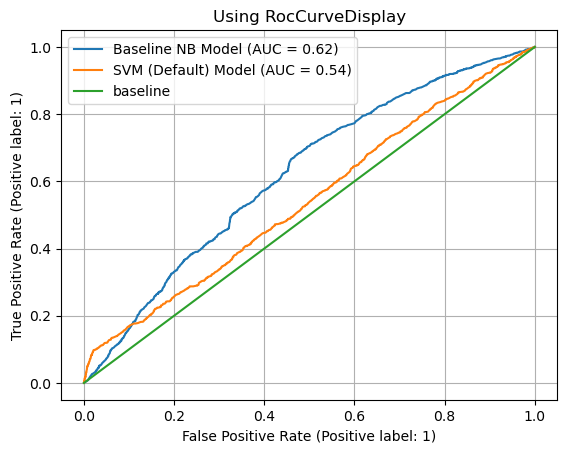

In [194]:
fig, ax = plt.subplots()
plot_roc_curve(Baseline_model, X_test, y_test,ax = ax, name = 'Baseline NB Model')
plot_roc_curve(SVM_default, X_test, y_test,ax = ax, name = 'SVM (Default) Model')
plt.grid()
plt.plot(np.arange(0, 1.1, .1), np.arange(0, 1.1, .1), label = 'baseline');
plt.title('Using RocCurveDisplay')
plt.legend();

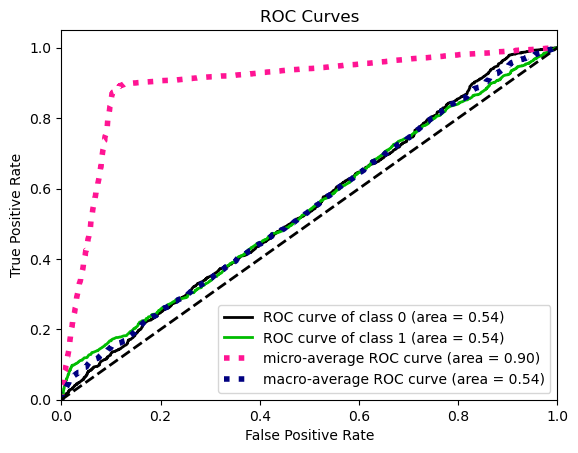

In [195]:
skplt.metrics.plot_roc_curve(y_test, SVM_default.predict_proba(X_test))
plt.show()

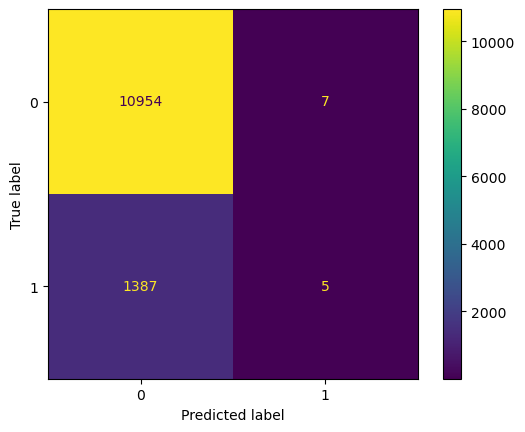

In [196]:
 plot_confusion_matrix(SVM_default,X_test,y_test);

In [197]:
print(classification_report(y_test,SVM_default.predict(X_test)))

              precision    recall  f1-score   support

           0       0.89      1.00      0.94     10961
           1       0.42      0.00      0.01      1392

    accuracy                           0.89     12353
   macro avg       0.65      0.50      0.47     12353
weighted avg       0.83      0.89      0.84     12353



### Problem 10: Model Comparisons

Now, we aim to compare the performance of the Logistic Regression model to our KNN algorithm, Decision Tree, and SVM models.  Using the default settings for each of the models, fit and score each.  Also, be sure to compare the fit time of each of the models.  Present your findings in a `DataFrame` similar to that below:

| Model | Train Time | Train Accuracy | Test Accuracy |
| ----- | ---------- | -------------  | -----------   |
|     |    |.     |.     |

In [204]:
res_dict = {'model': ['Baseline_NaiveBayes','Logistic_Regression - Default','KNN-default','DecisonTree_Default','SVM_default'],
           'Train Time': [Baseline_model_train_time,Log_default_train_time,KNN_default_train_time,DT_default_train_time,\
                          SVM_default_train_time],
           'Train Accuracy (auc)': [Baseline_model_train_accuracy,Log_default_train_accuracy,KNN_default_train_accuracy,DT_default_train_accuracy,
                                    SVM_default_train_accuracy],
           'Test Accuracy(auc) ': [Baseline_model_test_accuracy,Log_default_test_accuracy,KNN_default_test_accuracy,DT_default_test_accuracy,\
                                   SVM_default_test_accuracy]}
results_df = pd.DataFrame(res_dict).set_index('model')
#round off the values to nearest 2 decimal places for the results

results_df = results_df.round(decimals = 2)
results_df

,Train Time,Train Accuracy (auc),Test Accuracy(auc)
model,,,
Baseline_NaiveBayes,0.06,0.63,0.62
Logistic_Regression - Default,0.07,0.64,0.64
KNN-default,0.08,0.66,0.57
DecisonTree_Default,0.06,0.64,0.63
SVM_default,115.97,0.56,0.54


### Problem 11: Improving the Model

Now that we have some basic models on the board, we want to try to improve these.  Below, we list a few things to explore in this pursuit.

- More feature engineering and exploration.  For example, should we keep the gender feature?  Why or why not?
- Hyperparameter tuning and grid search.  All of our models have additional hyperparameters to tune and explore.  For example the number of neighbors in KNN or the maximum depth of a Decision Tree.  
- Adjust your performance metric

In [205]:
## Plotting rest of categorical columns

In [206]:
feature=['contact', 'month', 'day_of_week','poutcome']

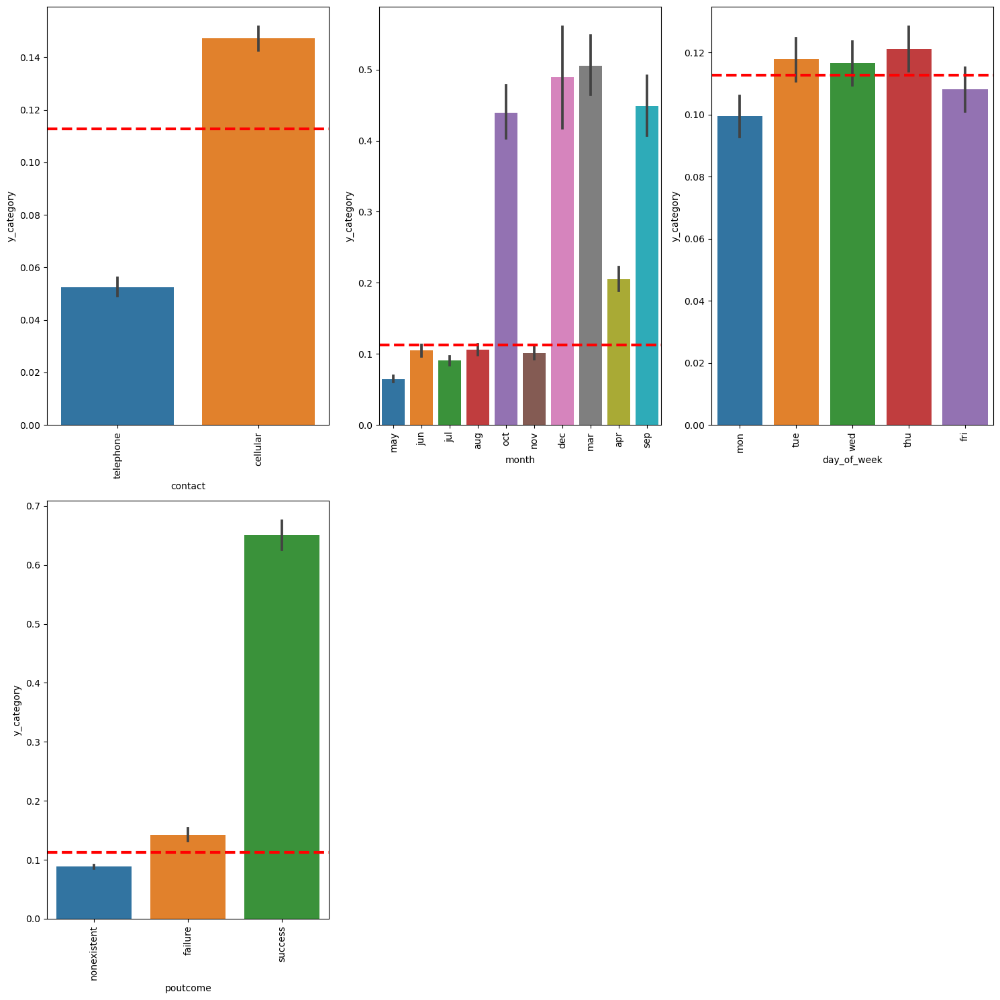

In [207]:
plt.figure(figsize=(15,15))
for i in enumerate(feature):
        plt.subplot(2,3,i[0]+1)
        #plt.ylim(7500,28000)
        fig=sns.barplot(x=i[1],y=df['y_category'],data=df[['contact', 'month', 'day_of_week','poutcome','y_category']])
        plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
        plt.xticks(rotation=90)
        plt.tight_layout(h_pad=1)
       

In [208]:
#Reducing the number of catergories in 'day of week' column

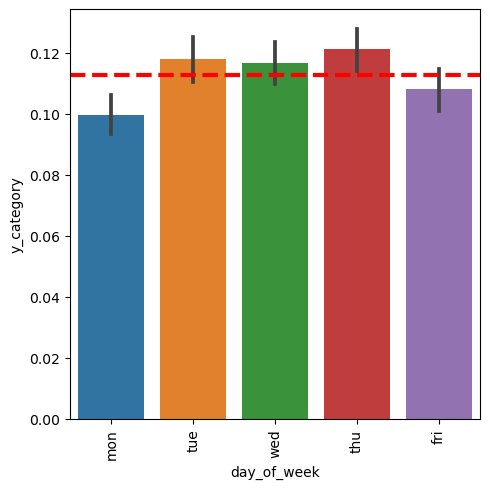

In [209]:
plt.figure(figsize=(5,5))
fig=sns.barplot(x=df['day_of_week'],y=df['y_category'],data=df)
plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
plt.xticks(rotation=90)
plt.tight_layout(h_pad=1)

In [210]:
df['day_of_week'].unique()

array(['mon', 'tue', 'wed', 'thu', 'fri'], dtype=object)

In [211]:
df.groupby('day_of_week')['y_category'].mean()

day_of_week
fri    0.108101
mon    0.099507
thu    0.121142
tue    0.117858
wed    0.116671
Name: y_category, dtype: float64

In [212]:
day_of_week_categories={'mon': 'day_of_week_rest',
                    'tue': 'day_of_week_tue_wed_thu', 
                    'wed':'day_of_week_tue_wed_thu', 
                    'thu':'day_of_week_tue_wed_thu', 
                    'fri':'day_of_week_rest', 
                    
                    
}

In [214]:
df['day_of_week_category']=df['day_of_week'].map(day_of_week_categories)

In [215]:
df.day_of_week_category.value_counts()

day_of_week_tue_wed_thu    24838
day_of_week_rest           16338
Name: day_of_week_category, dtype: int64

In [216]:
#Reducing the number of catergories in 'month' column

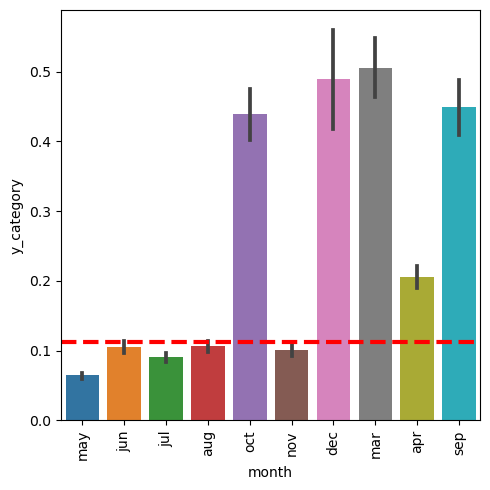

In [217]:
plt.figure(figsize=(5,5))
fig=sns.barplot(x=df['month'],y=df['y_category'],data=df)
plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
plt.xticks(rotation=90)
plt.tight_layout(h_pad=1)

In [218]:
df['month'].unique()

array(['may', 'jun', 'jul', 'aug', 'oct', 'nov', 'dec', 'mar', 'apr',
       'sep'], dtype=object)

In [219]:
df.groupby('month')['y_category'].mean()

month
apr    0.204865
aug    0.106056
dec    0.489011
jul    0.090389
jun    0.105115
mar    0.505495
may    0.064357
nov    0.101463
oct    0.439331
sep    0.449123
Name: y_category, dtype: float64

In [220]:
month_categories={'may': 'month_rest',
                    'jun': 'month_rest', 
                    'jul':'month_rest', 
                    'aug':'month_rest', 
                    'oct':'month_oct_dec_mar_apr_sep', 
                    'nov':'month_rest', 
                    'dec':'month_oct_dec_mar_apr_sep', 
                    'mar':'month_oct_dec_mar_apr_sep', 
                    'apr':'month_oct_dec_mar_apr_sep',
                     'sep':'month_oct_dec_mar_apr_sep'
                    
}

In [221]:
df['month_category']=df['month'].map(month_categories)

In [222]:
df.month_category.value_counts()

month_rest                   36530
month_oct_dec_mar_apr_sep     4646
Name: month_category, dtype: int64

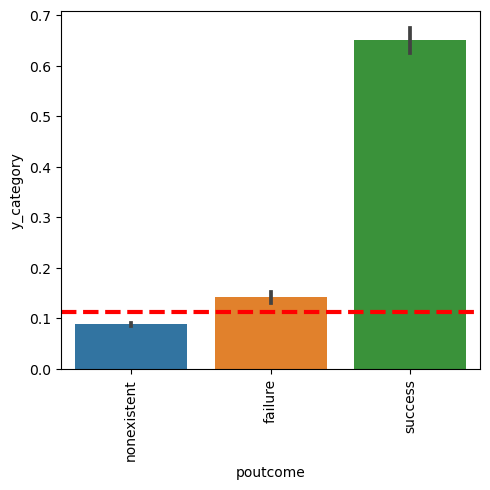

In [223]:
plt.figure(figsize=(5,5))
fig=sns.barplot(x=df['poutcome'],y=df['y_category'],data=df)
plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
plt.xticks(rotation=90)
plt.tight_layout(h_pad=1)

In [224]:
df['poutcome'].unique()

array(['nonexistent', 'failure', 'success'], dtype=object)

In [225]:
df.groupby('poutcome')['y_category'].mean()

poutcome
failure        0.142286
nonexistent    0.088324
success        0.651129
Name: y_category, dtype: float64

In [226]:
poutcome_categories={'nonexistent': 'poutcome_nonexistent',
                    'failure': 'poutcome_failure_success', 
                    'success':'poutcome_failure_success'                  
                                 
}

In [228]:
df['poutcome_category']=df['poutcome'].map(poutcome_categories)

In [229]:
df.poutcome_category.value_counts()

poutcome_nonexistent        35551
poutcome_failure_success     5625
Name: poutcome_category, dtype: int64

In [230]:
df.poutcome_category.value_counts()

poutcome_nonexistent        35551
poutcome_failure_success     5625
Name: poutcome_category, dtype: int64

In [231]:
#Reducing the number of catergories in 'age-bins'

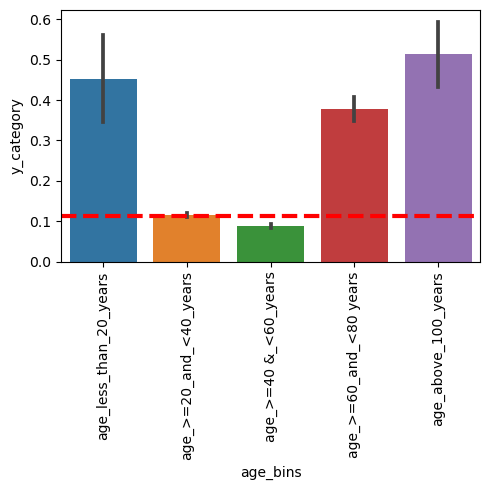

In [232]:
plt.figure(figsize=(5,5))
fig=sns.barplot(x=df['age_bins'],y=df['y_category'],data=df)
plt.axhline(df.y_category.mean(), color='r', linestyle='dashed', linewidth=3)
plt.xticks(rotation=90)
plt.tight_layout(h_pad=1)

In [233]:
df['age_bins'].unique()

['age_>=40 &_<60_years', 'age_>=20_and_<40_years', 'age_>=60_and_<80 years', 'age_less_than_20_years', 'age_above_100_years']
Categories (5, object): ['age_less_than_20_years' < 'age_>=20_and_<40_years' < 'age_>=40 &_<60_years' < 'age_>=60_and_<80 years' < 'age_above_100_years']

In [234]:
df.groupby('age_bins')['y_category'].mean()

age_bins
age_less_than_20_years    0.453333
age_>=20_and_<40_years    0.115560
age_>=40 &_<60_years      0.088012
age_>=60_and_<80 years    0.379079
age_above_100_years       0.513333
Name: y_category, dtype: float64

In [235]:
age_bins_categories={'age_less_than_20_years': 'age_bin_<20_and_>60',
                    'age_>=20_and_<40_years': 'age_bin_Rest', 
                    'age_>=40 &_<60_years':'age_bin_Rest' ,
                      'age_>=60_and_<80 years':'age_bin_<20_and_>60' ,
                      'age_above_100_years':'age_bin_<20_and_>60' ,
                                 
}

In [236]:
df['age_bins_category']=df['age_bins'].map(age_bins_categories)

In [237]:
df.age_bins_category.value_counts()

age_bin_Rest           39909
age_bin_<20_and_>60     1267
Name: age_bins_category, dtype: int64

In [238]:
df.drop('age_bins',axis=1,inplace=True)

In [239]:
feature1=['duration', 'campaign', 'pdays',
       'previous','emp.var.rate', 'cons.price.idx','cons.conf.idx','euribor3m', 'nr.employed']

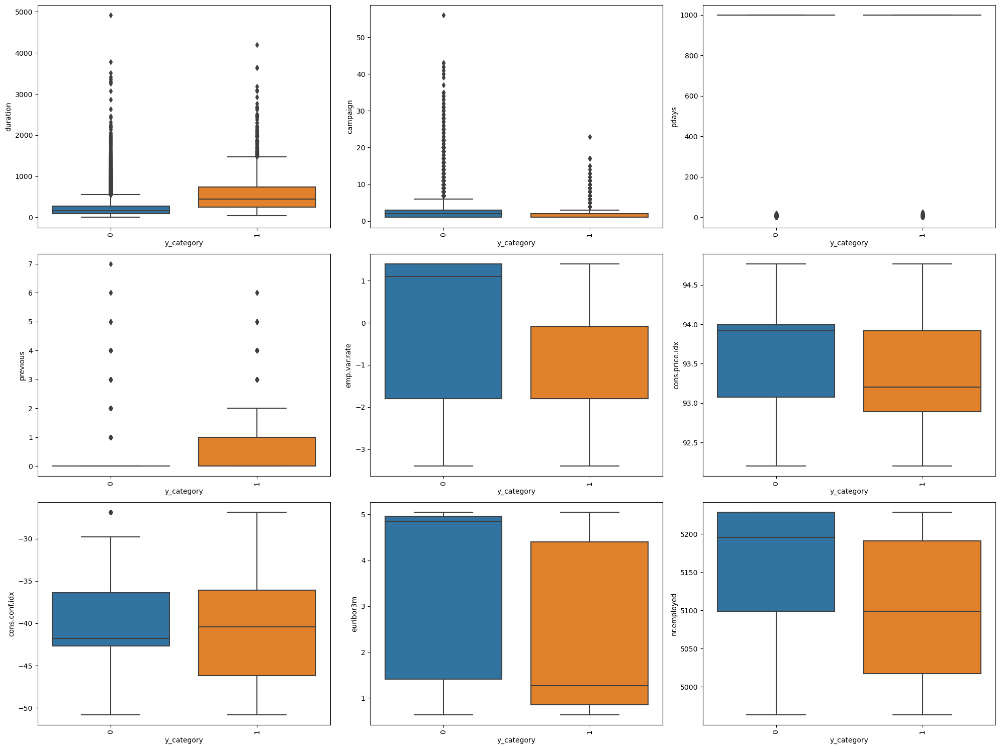

In [240]:
plt.figure(figsize=(20,15))
for i in enumerate(feature1):
        plt.subplot(3,3,i[0]+1)
        #plt.ylim(7500,28000)
        fig=sns.boxplot(x=df['y_category'],y=i[1],data=df[['duration', 'campaign', 'pdays',
       'previous','emp.var.rate', 'cons.price.idx','cons.conf.idx','euribor3m', 'nr.employed']])
        #plt.axhline(df.i[1].mean(), color='r', linestyle='dashed', linewidth=3)
        plt.xticks(rotation=90)
        plt.tight_layout(h_pad=1)

In [241]:
df_Final=df.copy(deep=True)

In [242]:
numerical_cols = df.select_dtypes(['float','int']).dropna(axis = 1)
numerical_cols.columns

Index(['age', 'duration', 'campaign', 'pdays', 'previous', 'emp.var.rate',
       'cons.price.idx', 'cons.conf.idx', 'euribor3m', 'nr.employed',
       'y_category'],
      dtype='object')

In [243]:
cols_to_scale =['duration', 'campaign', 'pdays','previous','emp.var.rate', 'cons.price.idx',
      'cons.conf.idx', 'euribor3m', 'nr.employed']

In [244]:
scaler=StandardScaler()
scaler.fit(df[cols_to_scale])
df[cols_to_scale]=scaler.transform(df[cols_to_scale])

In [245]:
object_cols = df.select_dtypes(['object']).dropna(axis = 1)
object_cols.columns

Index(['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact',
       'month', 'day_of_week', 'poutcome', 'y', 'job_category',
       'marital_category', 'education_category', 'default_category',
       'housing_category', 'loan_category', 'day_of_week_category',
       'month_category', 'poutcome_category', 'age_bins_category'],
      dtype='object')

In [246]:
df5= df.drop([ 'age','y', 'job',
       'marital', 'education', 'default',
       'housing', 'loan', 'month',
       'day_of_week', 'poutcome'
                    ],axis=1)

In [247]:
df6 = pd.get_dummies(df5,columns=['age_bins_category','contact', 'job_category', 'marital_category', 'education_category',
       'default_category', 'housing_category', 'loan_category','month_category','day_of_week_category','poutcome_category'])

In [248]:
X = df6[['duration', 'campaign', 'pdays', 'previous', 'emp.var.rate',
       'cons.price.idx', 'cons.conf.idx', 'euribor3m', 'nr.employed',
       'age_bins_category_age_bin_<20_and_>60',
       'age_bins_category_age_bin_Rest', 'contact_cellular',
       'contact_telephone',
       'job_category_job_admin_retired_unemployed_student',
       'job_category_job_rest', 'marital_category_marital_rest',
       'marital_category_marital_single_unknown',
       'education_category_education_rest',
       'education_category_education_unknown_university.degree_illiterate',
       'default_category_default_no', 'default_category_default_rest',
       'housing_category_housing_rest', 'housing_category_housing_yes',
       'loan_category_loan_no', 'loan_category_loan_rest',
       'month_category_month_oct_dec_mar_apr_sep', 'month_category_month_rest',
       'day_of_week_category_day_of_week_rest',
       'day_of_week_category_day_of_week_tue_wed_thu',
       'poutcome_category_poutcome_failure_success',
       'poutcome_category_poutcome_nonexistent'
         
                
       ]]

In [249]:
vif_data = pd.DataFrame()
vif_data["feature"] =X.columns
  
# calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(X.values, i)
                          for i in range(len(X.columns))]
print(vif_data)

                                              feature        VIF
0                                            duration   1.012511
1                                            campaign   1.040841
2                                               pdays   1.635122
3                                            previous   5.499936
4                                        emp.var.rate  38.507710
5                                      cons.price.idx   9.281687
6                                       cons.conf.idx   2.940291
7                                           euribor3m  65.283899
8                                         nr.employed  33.635917
9               age_bins_category_age_bin_<20_and_>60        inf
10                     age_bins_category_age_bin_Rest        inf
11                                   contact_cellular        inf
12                                  contact_telephone        inf
13  job_category_job_admin_retired_unemployed_student        inf
14                       

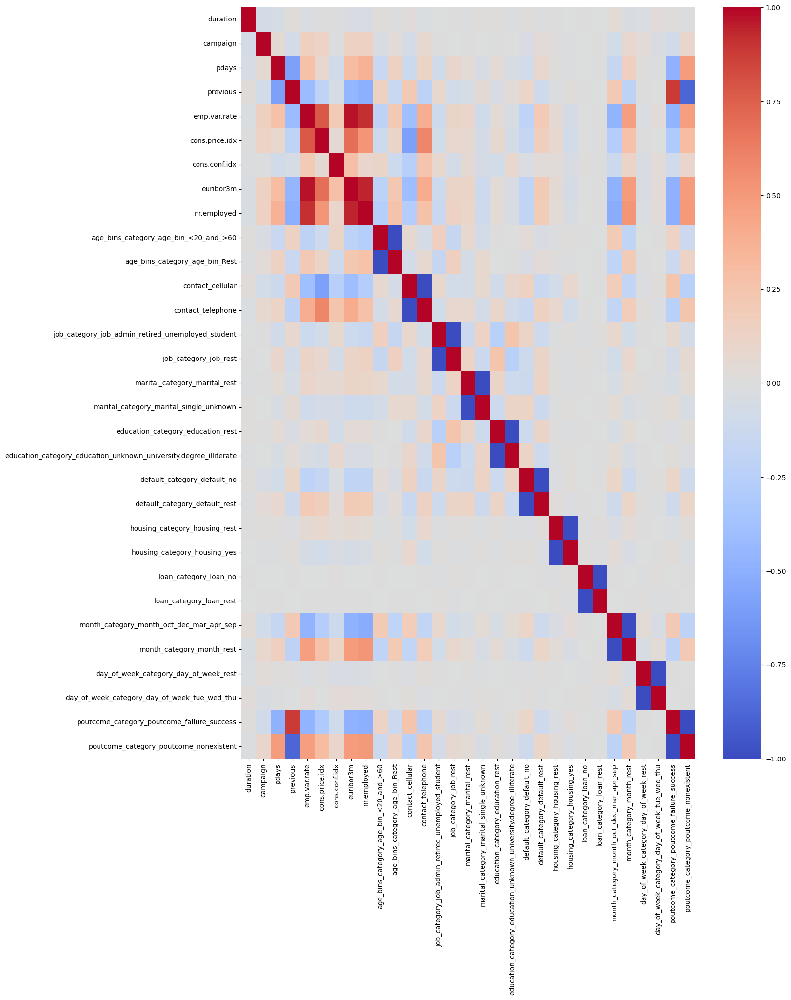

In [250]:
plt.figure(figsize=(15,20))
sns.heatmap(X.corr(),cmap='coolwarm');

In [251]:
X_adjusted = df6[['duration', 
                  'campaign', 
                 # 'pdays',
                  'previous',
                  #'emp.var.rate',
       'cons.price.idx', 
                  'cons.conf.idx',
                 # 'euribor3m', 
                  'nr.employed',
        
                  'age_bins_category_age_bin_<20_and_>60',
      # 'age_bins_category_age_bin_Rest', 
                  'contact_cellular',
       #'contact_telephone',
       'job_category_job_admin_retired_unemployed_student',
     #  'job_category_job_rest', 
     #             'marital_category_marital_rest',
       'marital_category_marital_single_unknown',
    #   'education_category_education_rest',
       'education_category_education_unknown_university.degree_illiterate',
       'default_category_default_no',
       #           'default_category_default_rest',
      # 'housing_category_housing_rest',
                  'housing_category_housing_yes',
       'loan_category_loan_no', 
       #           'loan_category_loan_rest',
       'month_category_month_oct_dec_mar_apr_sep', 
                #  'month_category_month_rest',
       #'day_of_week_category_day_of_week_rest',
       'day_of_week_category_day_of_week_tue_wed_thu',
       'poutcome_category_poutcome_failure_success',
       #'poutcome_category_poutcome_nonexistent'
       ]]

In [252]:
vif_data = pd.DataFrame()
vif_data["feature"] =X_adjusted.columns
  
# calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(X_adjusted.values, i)
                          for i in range(len(X_adjusted.columns))]
print(vif_data)

                                              feature       VIF
0                                            duration  1.010577
1                                            campaign  1.033251
2                                            previous  4.637255
3                                      cons.price.idx  1.994729
4                                       cons.conf.idx  1.153345
5                                         nr.employed  2.382826
6               age_bins_category_age_bin_<20_and_>60  1.181521
7                                    contact_cellular  4.126862
8   job_category_job_admin_retired_unemployed_student  1.694940
9             marital_category_marital_single_unknown  1.466601
10  education_category_education_unknown_universit...  1.648811
11                        default_category_default_no  4.121404
12                       housing_category_housing_yes  2.000788
13                              loan_category_loan_no  4.055329
14           month_category_month_oct_de

In [253]:
df7=df6[['duration', 
                  'campaign',                
                  'previous',                
       'cons.price.idx', 
                  'cons.conf.idx',                
                  'nr.employed',        
                  'age_bins_category_age_bin_<20_and_>60',      
                  'contact_cellular',      
       'job_category_job_admin_retired_unemployed_student',     
       'marital_category_marital_single_unknown',   
       'education_category_education_unknown_university.degree_illiterate',
         'default_category_default_no',      
                  'housing_category_housing_yes',
       'loan_category_loan_no',                  
       'month_category_month_oct_dec_mar_apr_sep',                 
       'day_of_week_category_day_of_week_tue_wed_thu',
       'poutcome_category_poutcome_failure_success',
                'y_category'   ]]

In [254]:
Xmul = df7.drop('y_category',axis=1)
ymul =df7['y_category']

In [255]:
X_trainmul, X_testmul, y_trainmul, y_testmul = train_test_split(Xmul, ymul, test_size=0.30, random_state=42,stratify=ymul)

In [256]:
weights = np.linspace(0.05, 0.99, 25)
tuned_parameters_mul = [{'Log__C': [0.01, 0.1, 1, 10,100],
                     'Log__penalty': ['l2'],
                     'Log__solver': ['newton_cg','liblinear', 'lbfgs','sag','saga'],
                    'Log__class_weight': [{0: x, 1: 1.0-x} for x in weights]
                    
                    },
                    {'Log__C': [0.01, 0.1, 1,10,100],
                     'Log__penalty': ['l1'],
                     'Log__solver': ['liblinear','saga'],
                      'Log__class_weight': [{0: x, 1: 1.0-x} for x in weights]
                    }]

In [257]:
Log_pipe_grid_mul=Pipeline([('Log',LogisticRegression())])

In [258]:
Log_Grid_mul=GridSearchCV(Log_pipe_grid_mul,param_grid=tuned_parameters_mul,cv=5,n_jobs=-1,scoring='roc_auc' )

In [259]:
Log_start_grid_mul = time.time()
Log_Grid_mul.fit(X_trainmul,y_trainmul)
Log_end_grid_mul= time.time()
Log_grid_train_time_mul= Log_end_grid_mul -Log_start_grid_mul
Log_grid_train_time_mul

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/jo

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/jo

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/jo

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_63e7a8b308e64a0d9b6dc0c4be4df54f_3b819379cd5a402ab0b2defab5409c70/14181-140294505230880-708c52884c7041198ec08e6e82296d78.pkl is not not bytes aligned. This 

300.2904095649719

In [260]:
Log_Grid_bestParams_mul=Log_Grid_mul.best_params_
Log_Grid_bestParams_mul

{'Log__C': 1,
 'Log__class_weight': {0: 0.08916666666666667, 1: 0.9108333333333334},
 'Log__penalty': 'l2',
 'Log__solver': 'liblinear'}

In [261]:
Log_Grid_train_accuracy_mul=roc_auc_score(y_trainmul,Log_Grid_mul.predict_proba(X_trainmul)[:, 1])

Log_Grid_train_accuracy_mul

0.9255698747064132

In [262]:
Log_Grid_test_accuracy_mul=roc_auc_score(y_testmul,Log_Grid_mul.predict_proba(X_testmul)[:, 1])

Log_Grid_test_accuracy_mul

0.9275792137117282

In [263]:
Log_pipe_grid_mul_optimal= Pipeline([('Log',LogisticRegression(
                       C= 1,
 class_weight= {0: 0.05, 1: 0.95},
 penalty= 'l1',
 solver='liblinear'       )),
                         ])

In [264]:
Log_pipe_grid_mul_optimal.fit(X_trainmul,y_trainmul)

Pipeline(steps=[('Log',
                 LogisticRegression(C=1, class_weight={0: 0.05, 1: 0.95},
                                    penalty='l1', solver='liblinear'))])

In [265]:
feature_names =X_trainmul.columns

coefs = pd.DataFrame(
  Log_pipe_grid_mul_optimal['Log'].coef_.T,
   columns=["Coefficients"],
    index=feature_names,
)

coefs

,Coefficients
duration,1.967158
campaign,-0.098431
previous,0.163573
cons.price.idx,-0.150926
cons.conf.idx,0.190792
nr.employed,-1.047551
age_bins_category_age_bin_<20_and_>60,0.643778
contact_cellular,0.423360
job_category_job_admin_retired_unemployed_student,0.248744
marital_category_marital_single_unknown,0.219722


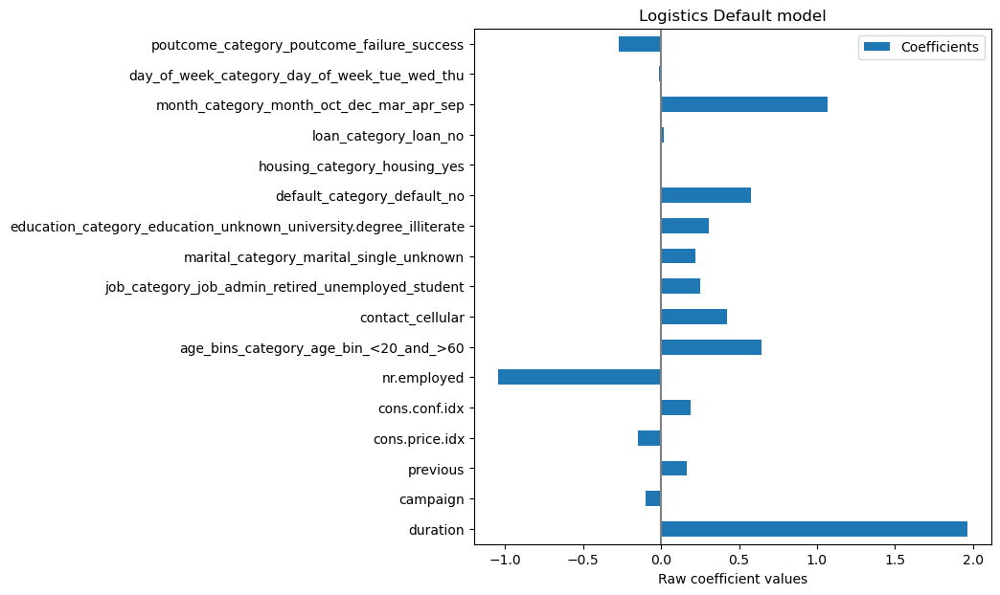

In [266]:
coefs.plot.barh(figsize=(9, 7))
plt.title("Logistics Default model")
plt.axvline(x=0, color=".5")
plt.xlabel("Raw coefficient values")
plt.subplots_adjust(left=0.3)

In [267]:
cv = RepeatedKFold(n_splits=5, n_repeats=5, random_state=0)
cv_model_log_mul = cross_validate(
   Log_pipe_grid_mul_optimal,
   X_trainmul,
    y_trainmul,   
    
    cv=cv,
    return_estimator=True,
    n_jobs=2,
)
coefs = pd.DataFrame(
    [est[-1].coef_[0] for est in cv_model_log_mul["estimator"]],\
    columns=feature_names
)

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_454981f374434727adaff64df4e6b726_101e8e9f0eb6458e90dbf8bbd895bb59/14181-140294575418960-98a2590e58ec43fbb03ca9f1695b78ae.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_454981f374434727adaff64df4e6b726_101e8e9f0eb6458e90dbf8bbd895bb59/14181-140294575418960-98a2590e58ec43fbb03ca9f1695b78ae.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_454981f374434727adaff64df4e6b726_101e8e9f0eb6458e90dbf8bbd895bb59/14181-140294575418960-98a2590e58ec43fbb03ca9f1695b78ae.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

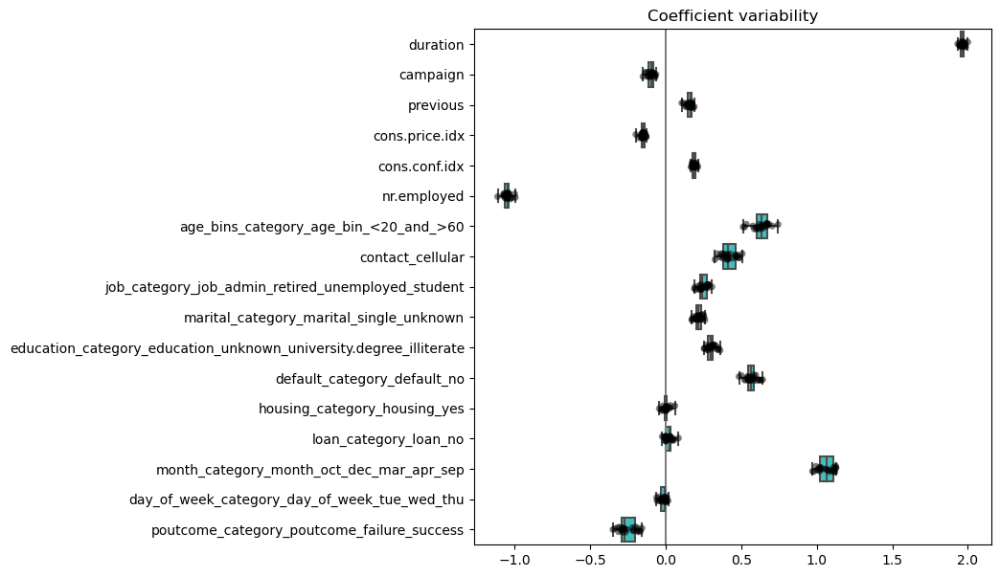

In [268]:
plt.figure(figsize=(9, 7))
sns.stripplot(data=coefs, orient="h", color="k", alpha=0.5)
sns.boxplot(data=coefs, orient="h", color="cyan", saturation=0.5, whis=10)
plt.axvline(x=0, color=".5")
plt.title("Coefficient variability")
plt.subplots_adjust(left=0.3)

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_454981f374434727adaff64df4e6b726_f9d5b1cbffc04cacbbcc6c0680f47c25/14181-140294575418960-98a2590e58ec43fbb03ca9f1695b78ae.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [-0.34955143 -0.34955143  1.6708205  ... -0.34955143 -0.34955143
  -0.34955143]
 [-0.64910011 -0.22756153 -1.17947856 ... -1.17947856  0.59132899
  -0.64910011]
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_454981f374434727adaff64df4e6b726_f9d5b1cbffc04cacbbcc6c0680f47c25/14181-140294575418960-98a2590e58ec43fbb03ca9f1695b78ae.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See h

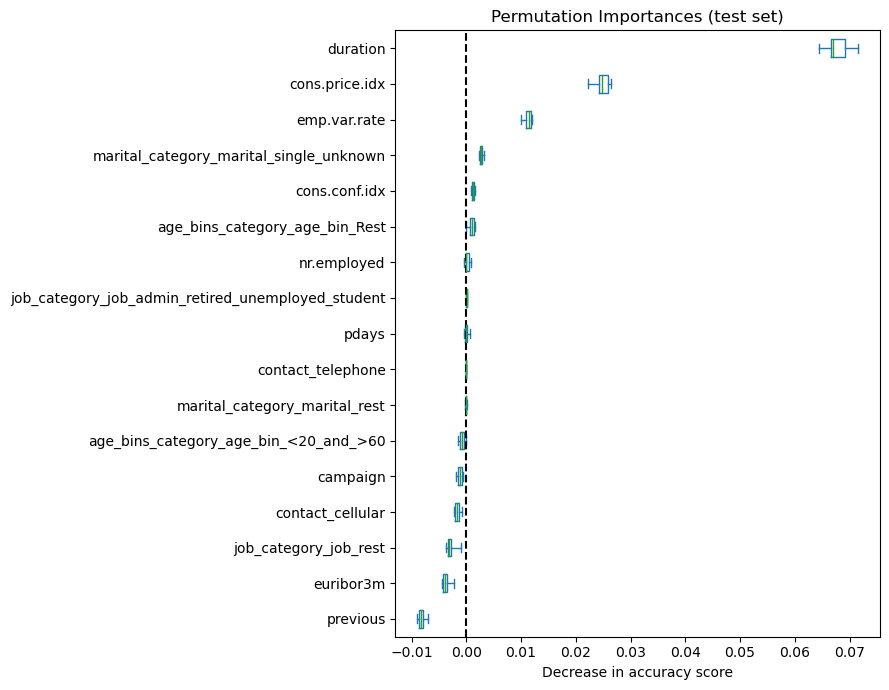

In [269]:
result = permutation_importance(
    Log_pipe_grid_mul_optimal,X_trainmul,y_trainmul, n_repeats=10, random_state=42, n_jobs=2
)

sorted_importances_idx = result.importances_mean.argsort()
importances = pd.DataFrame(
    result.importances[sorted_importances_idx].T,
    columns=X.columns[sorted_importances_idx],
)
ax = importances.plot.box(vert=False, whis=10,figsize=(9, 7))
ax.set_title("Permutation Importances (test set)")
ax.axvline(x=0, color="k", linestyle="--")
ax.set_xlabel("Decrease in accuracy score")
ax.figure.tight_layout()

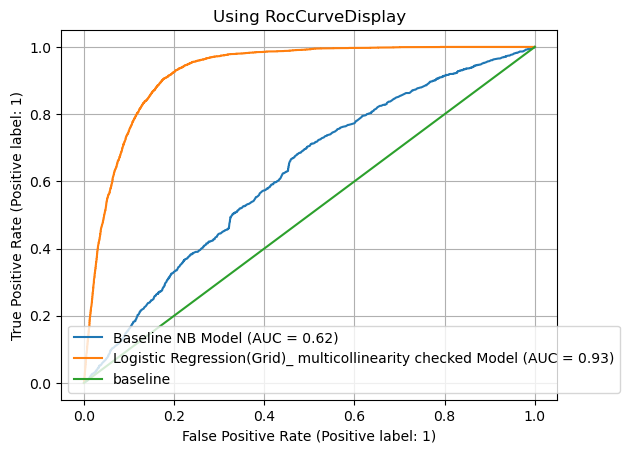

In [270]:
fig, ax = plt.subplots()
plot_roc_curve(Baseline_model, X_test, y_test,ax = ax, name = 'Baseline NB Model')
plot_roc_curve(Log_Grid_mul, X_trainmul,y_trainmul,ax = ax, name = 'Logistic Regression(Grid)_ multicollinearity checked Model')
plt.grid()
plt.plot(np.arange(0, 1.1, .1), np.arange(0, 1.1, .1), label = 'baseline');
plt.title('Using RocCurveDisplay')
plt.legend();

In [271]:
#Logistic Regression- Grid Search with all columns and all parameters

In [272]:
df1=df[['age_bins_category', 'contact','job_category', 'marital_category', 'education_category',
       'default_category', 'housing_category', 'loan_category',
       'month_category', 'day_of_week_category', 'poutcome_category',
        'duration', 'campaign', 'pdays',
       'previous','emp.var.rate', 'cons.price.idx','cons.conf.idx','euribor3m', 'nr.employed' ,'y_category']]

In [273]:
Xgrid = df.drop(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan',
                 'month', 'day_of_week', 'poutcome','y_category','y']
                 ,axis=1)
ygrid =df['y_category']

In [274]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(Xgrid, ygrid, test_size=0.30, random_state=42,stratify=ygrid)

In [275]:
categorical_features = ['age_bins_category','job_category', 'marital_category', 'education_category',
       'default_category', 'housing_category', 'loan_category','contact',
       'month_category', 'day_of_week_category', 'poutcome_category']

numerical_features = ['duration', 'campaign', 'pdays',
       'previous','emp.var.rate', 'cons.price.idx','cons.conf.idx','euribor3m', 'nr.employed']

numeric_transformer = Pipeline(
    steps=[
        ("scaler", StandardScaler())]
)

categorical_transformer =  Pipeline(steps=[
    ('onehot', OneHotEncoder(drop="if_binary"))
])



preprocessor_GS = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numerical_features),
        ("cat", categorical_transformer, categorical_features)
        
    ])

In [276]:
weights = np.linspace(0.05, 0.99, 25)
tuned_parameters = [{'Log__C': [0.01, 0.1, 1, 10,100],
                     'Log__penalty': ['l2'],
                     'Log__solver': ['newton_cg','liblinear', 'lbfgs','sag','saga'],
                    'Log__class_weight': [{0: x, 1: 1.0-x} for x in weights]
                    
                    },
                    {'Log__C': [0.01, 0.1, 1,10,100],
                     'Log__penalty': ['l1'],
                     'Log__solver': ['liblinear','saga'],
                      'Log__class_weight': [{0: x, 1: 1.0-x} for x in weights]
                    }]

In [277]:
Log_pipe_grid= Pipeline([('preprocessor', preprocessor_GS),
                                                  ('Log',LogisticRegression())])

In [278]:
Log_Grid= GridSearchCV(Log_pipe_grid,param_grid=tuned_parameters,cv=5,n_jobs=-1,scoring='roc_auc')

In [279]:
Log_start_grid = time.time()
Log_Grid.fit(X_train1,y_train1)
Log_end_grid= time.time()
Log_grid_train_time= Log_end_grid -Log_start_grid
Log_grid_train_time

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/s

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/s

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 .

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/s

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reache

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 .

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/s

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/s

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 .

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 .

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/s

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/s

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 .

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/s

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 .

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_d6cadeafb45a47d6acbffa16c00321a5_7dd309a38b024de0886191ddc2b2464f/14181-140294504625968-360afb1a552247399dd72ae88643710c.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

915.0738749504089

In [280]:
Log_Grid_bestParams=Log_Grid.best_params_
Log_Grid_bestParams

{'Log__C': 1,
 'Log__class_weight': {0: 0.08916666666666667, 1: 0.9108333333333334},
 'Log__penalty': 'l2',
 'Log__solver': 'liblinear'}

In [281]:
Log_Grid_train_accuracy=roc_auc_score(y_train1,Log_Grid.predict_proba(X_train1)[:, 1])

Log_Grid_train_accuracy

0.9333768935093618

In [282]:
Log_Grid_test_accuracy=roc_auc_score(y_test1,Log_Grid.predict_proba(X_test1)[:, 1])

Log_Grid_test_accuracy

0.933647915231327

In [283]:
y_pred_Log_Grid = Log_Grid.predict(X_test1)
fp_rate, tp_rate, thresholds = roc_curve(y_test1, y_pred_Log_Grid)
metrics.auc(fp_rate, tp_rate)

0.8753062385762688

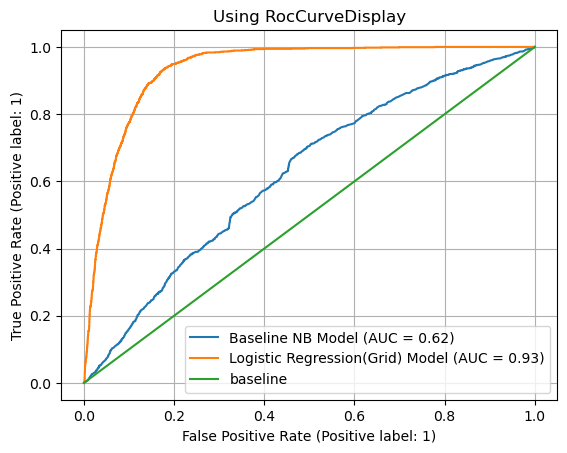

In [284]:
fig, ax = plt.subplots()
plot_roc_curve(Baseline_model, X_test, y_test,ax = ax, name = 'Baseline NB Model')
plot_roc_curve(Log_Grid, X_test1, y_test1,ax = ax, name = 'Logistic Regression(Grid) Model')
plt.grid()
plt.plot(np.arange(0, 1.1, .1), np.arange(0, 1.1, .1), label = 'baseline');
plt.title('Using RocCurveDisplay')
plt.legend();

In [314]:
#Decision Tree- Grid Search with all columns and all parameters

In [315]:
max_depth_values=range(1, 10, 1)
criterion_values=['gini','entropy']
min_samples_leaf_values=range(1, 5, 1)
min_samples_split_values=np.linspace(0.05, 1.0, 10, endpoint=True)

In [316]:
parameters2 = {'DT__max_depth': max_depth_values,
              'DT__criterion': criterion_values,
          'DT__min_samples_leaf': min_samples_leaf_values,
          'DT__min_samples_split': min_samples_split_values,
          'DT__class_weight':[{0: w} for w in [1, 2, 4, 6, 10]]
         }

In [317]:
DT_pipe_grid= Pipeline([("preprocessor", preprocessor_GS),('DT',DecisionTreeClassifier())])

In [318]:

DT_Grid = GridSearchCV(DT_pipe_grid,param_grid=parameters2,cv=5,n_jobs=-1,scoring='roc_auc')

In [319]:
DT_start = time.time()
DT_Grid.fit(X_train1,y_train1)
DT_end = time.time()
DT_fit_time_grid= DT_end-DT_start
DT_fit_time_grid

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_fbbdb6e94b924b31b8ccda03c0af1a8a/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

1064.0553703308105

In [320]:
DT_Grid_bestParams=DT_Grid.best_params_
DT_Grid_bestParams
{'DT__class_weight': {0: 4},
 'DT__criterion': 'entropy',
 'DT__max_depth': 9,
 'DT__min_samples_leaf': 1,
 'DT__min_samples_split': 0.05}

{'DT__class_weight': {0: 4},
 'DT__criterion': 'entropy',
 'DT__max_depth': 9,
 'DT__min_samples_leaf': 1,
 'DT__min_samples_split': 0.05}

In [321]:
DT_Grid_train_accuracy=roc_auc_score(y_train1,DT_Grid.predict_proba(X_train1)[:, 1])

DT_Grid_train_accuracy

0.939751609218644

In [322]:
DT_Grid_test_accuracy=roc_auc_score(y_test1,DT_Grid.predict_proba(X_test1)[:, 1])

DT_Grid_test_accuracy

0.9361615621005299

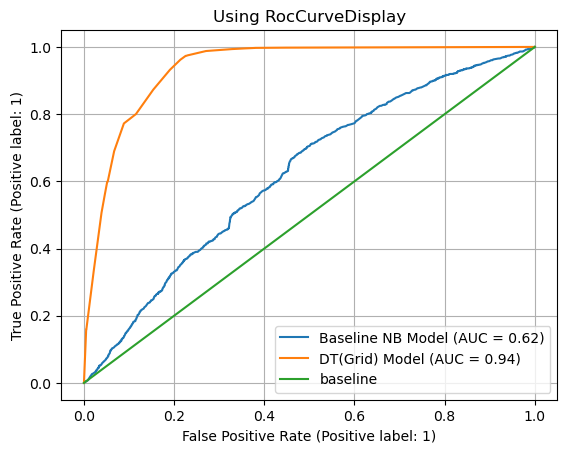

In [324]:
fig, ax = plt.subplots()
plot_roc_curve(Baseline_model, X_test, y_test,ax = ax, name = 'Baseline NB Model')
plot_roc_curve(DT_Grid, X_test1, y_test1,ax = ax, name = 'DT(Grid) Model')
plt.grid()
plt.plot(np.arange(0, 1.1, .1), np.arange(0, 1.1, .1), label = 'baseline');
plt.title('Using RocCurveDisplay')
plt.legend();

In [325]:
print(classification_report(y_test1,DT_Grid.predict(X_test1)))

              precision    recall  f1-score   support

           0       0.90      1.00      0.95     10961
           1       0.80      0.16      0.27      1392

    accuracy                           0.90     12353
   macro avg       0.85      0.58      0.61     12353
weighted avg       0.89      0.90      0.87     12353



In [285]:
#Using SVM - Grid Search with all columns and all parameters

In [286]:
parameters_SV ={'SVC__C':[1,5,10,100],
            'SVC__kernel':['sigmoid','linear', 'poly', 'rbf'],
            'SVC__gamma':['scale','auto']
                    }

In [287]:
SVM_pipe_Grid = Pipeline(
    steps=[("preprocessor", preprocessor_GS), ('SVC',SVC(class_weight='balanced',probability=True))]
)

In [288]:
SVM_Grid= HalvingGridSearchCV(SVM_pipe_Grid, parameters_SV, cv=5,factor=2,max_resources=40,aggressive_elimination=True)


In [289]:
SVM_start = time.time()
SVM_Grid.fit(X_train1,y_train1)
SVM_end=time.time()
SVM_fit_time_grid=SVM_end-SVM_start
SVM_fit_time_grid

171.40957069396973

In [290]:
SVM_Grid_bestParams=SVM_Grid.best_params_
SVM_Grid_bestParams

{'SVC__C': 100, 'SVC__gamma': 'auto', 'SVC__kernel': 'rbf'}

In [291]:
SVM_Grid_train_accuracy=roc_auc_score(y_train1,SVM_Grid.predict_proba(X_train1)[:, 1])
SVM_Grid_train_accuracy

0.9605598919586896

In [292]:
SVM_Grid_test_accuracy=roc_auc_score(y_test1,SVM_Grid.predict_proba(X_test1)[:, 1])
SVM_Grid_test_accuracy

0.9241669393156718

In [293]:
y_pred_SVM_Grid = SVM_Grid.predict(X_test1)
fp_rate, tp_rate, thresholds = roc_curve(y_test1, y_pred_SVM_Grid)
metrics.auc(fp_rate, tp_rate)

0.8613726946740115

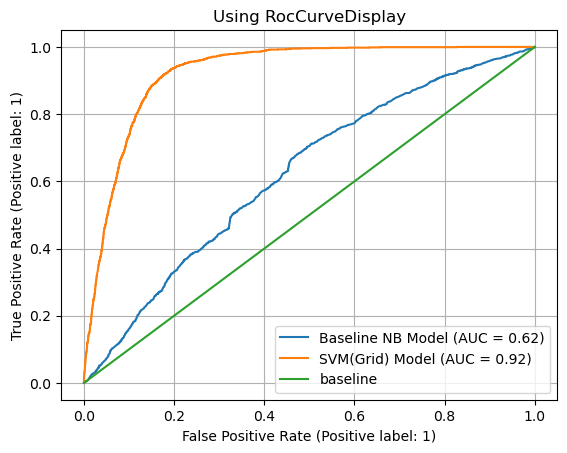

In [294]:
fig, ax = plt.subplots()
plot_roc_curve(Baseline_model, X_test, y_test,ax = ax, name = 'Baseline NB Model')
plot_roc_curve(SVM_Grid, X_test1, y_test1,ax = ax, name = 'SVM(Grid) Model')
plt.grid()
plt.plot(np.arange(0, 1.1, .1), np.arange(0, 1.1, .1), label = 'baseline');
plt.title('Using RocCurveDisplay')
plt.legend();

In [295]:
print(classification_report(y_test1,SVM_Grid.predict(X_test1)))

              precision    recall  f1-score   support

           0       0.98      0.86      0.92     10961
           1       0.44      0.86      0.58      1392

    accuracy                           0.86     12353
   macro avg       0.71      0.86      0.75     12353
weighted avg       0.92      0.86      0.88     12353



In [298]:
#KNN algorithm - Grid Search with all columns and all parameters

In [299]:
k_values    = range(1,41,2)
weights    = ['uniform' , 'distance']
#algos      = ['auto', 'ball_tree', 'kd_tree', 'brute']
leaf_sizes = range(10, 60, 10)    
metrics = ["euclidean", "manhattan", "chebyshev", "minkowski", "mahalanobis"]

In [300]:
parameters =  {'KNN__n_neighbors':k_values,
    'KNN__weights': weights,
     #'KNN__algorithm': algos,
     'KNN__leaf_size':leaf_sizes,
      'KNN__metric':metrics
    }

In [301]:
KNN_pipe = Pipeline(
    steps=[("preprocessor", preprocessor_GS), ('KNN',KNeighborsClassifier())]
)

In [302]:
KNN_Grid = GridSearchCV(KNN_pipe,param_grid=parameters,cv=5,n_jobs=-1,scoring='roc_auc')

In [304]:
KNN_start = time.time()
KNN_Grid.fit(X_train1,y_train1)
KNN_end = time.time()
KNN_fit_time_grid= KNN_end-KNN_start
KNN_fit_time_grid

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarn

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarn

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarn

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 536, in predict_proba
    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/m

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 536, in predict_proba
    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    ne

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 536, in predict_proba
    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  Fil

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 216, in __call__
    return self._score(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 369, in _score
    y_pred = method_caller(clf, "predict_proba", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 113, in <lambda>
    out = lambda *args, **kwargs: self.fn(obj, *args, **kwargs)  # noqa
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

    return self.steps[-1][1].predict_proba(Xt, **predict_proba_params)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py", line 256, in predict_proba
    neigh_dist, neigh_ind = self.kneighbors(X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_base.py", line 752, in kneighbors
    chunked_results = list(
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1709, in pairwise_distances_chunked
    params = _precompute_metric_params(X, Y, metric=metric, **kwds)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/pairwise.py", line 1551, in _precompute_metric_params
    raise ValueError(
ValueError: The 'VI' parameter is required for the mahalanobis metric when Y is passed.

  warnings.warn(
/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -

/home/melke/anaconda3/lib/python3.9/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[-0.83807942 -0.43700295  0.74308743 ...  1.25985904 -0.76094933
  -0.62982818]
 [-0.20498953 -0.56596326 -0.56596326 ... -0.56596326 -0.56596326
  -0.56596326]
 [ 0.19544346  0.19544346  0.19544346 ...  0.19544346  0.19544346
   0.19544346]
 ...
 [-0.32350911  0.95139369 -1.23106704 ... -1.23106704 -0.47476877
  -0.32350911]
 [ 0.230456    0.77415487 -1.35797498 ... -1.34932653  0.77646112
   0.30656231]
 [ 0.39813061  0.84518642 -0.94026868 ... -0.94026868  0.84518642
   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

   0.39813061]] loaded from the file /dev/shm/joblib_memmapping_folder_14181_23673604ca8845b7a54a92db5d81dd4d_6c937d40ba134ccaae723c46d3edfd62/14181-140294508420064-48bf45d519e346b5ae13f91c0725b2c6.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py",

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:770: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    y_pred = method_caller(clf, "decision_function", X)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 68, in _cached_call
    return getattr(estimator, method)(*args, **kwargs)
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/utils/metaestimators.py", line 109, in __get__
    if not self.check(obj):
  File "/home/melke/anaconda3/lib/python3.9/site-packages/sklearn/pipeline.py", line 45, in check
    getattr(self._final_estimator, attr)
AttributeError: 'KNeighborsClassifier' object has no attribute 'decision_function'

During handling of the above exception, another exception 

6555.83189702034

In [305]:
KNN_Grid_bestParams=KNN_Grid.best_params_
KNN_Grid_bestParams

{'KNN__leaf_size': 10,
 'KNN__metric': 'euclidean',
 'KNN__n_neighbors': 39,
 'KNN__weights': 'uniform'}

In [306]:
KNN_Grid_train_accuracy=roc_auc_score(y_train1,KNN_Grid.predict_proba(X_train1)[:, 1])

KNN_Grid_train_accuracy

0.9440854862875276

In [307]:
KNN_Grid_test_accuracy=roc_auc_score(y_test1,KNN_Grid.predict_proba(X_test1)[:, 1])

KNN_Grid_test_accuracy

0.9334750845998403

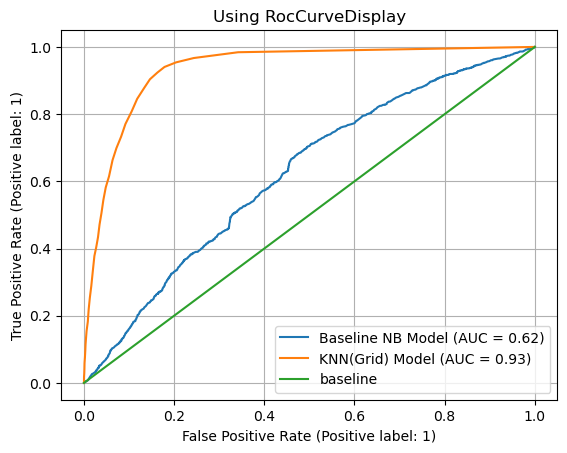

In [310]:
fig, ax = plt.subplots()
plot_roc_curve(Baseline_model, X_test, y_test,ax = ax, name = 'Baseline NB Model')
plot_roc_curve(KNN_Grid, X_test1, y_test1,ax = ax, name = 'KNN(Grid) Model')
plt.grid()
plt.plot(np.arange(0, 1.1, .1), np.arange(0, 1.1, .1), label = 'baseline');
plt.title('Using RocCurveDisplay')
plt.legend();

In [311]:
print(classification_report(y_test1,KNN_Grid.predict(X_test1)))

              precision    recall  f1-score   support

           0       0.93      0.97      0.95     10961
           1       0.65      0.40      0.50      1392

    accuracy                           0.91     12353
   macro avg       0.79      0.69      0.72     12353
weighted avg       0.90      0.91      0.90     12353



In [312]:
pd.options.display.max_colwidth = 300

In [326]:
res_dict_final = {'model': ['Baseline_NaiveBayes','Logistic_Regression-Default','KNN-default','DecisonTree_Default',\
                            'SVM_default','Logistic Regression-Multicollinearity','Logistic_Regression-GridSearch',\
                            'KNN-GridSearch','DecisonTree_GridSearch',\
                            'SVM_RandomizedSearch'],
           'Train Time': [Baseline_model_train_time,Log_default_train_time,KNN_default_train_time,DT_default_train_time,\
                          SVM_default_train_time,Log_grid_train_time_mul,Log_grid_train_time,KNN_fit_time_grid,\
                          DT_fit_time_grid,\
                          SVM_fit_time_grid],
           'Train Accuracy (auc)': [Baseline_model_train_accuracy,Log_default_train_accuracy,\
                                    KNN_default_train_accuracy,DT_default_train_accuracy,
                                    SVM_default_train_accuracy,Log_Grid_train_accuracy_mul,Log_Grid_train_accuracy,\
                                    KNN_Grid_train_accuracy,DT_Grid_train_accuracy,SVM_Grid_train_accuracy
                                    ],
           'Test Accuracy(auc) ': [Baseline_model_test_accuracy,Log_default_test_accuracy,\
                                   KNN_default_test_accuracy,DT_default_test_accuracy,\
                                   SVM_default_test_accuracy,Log_Grid_test_accuracy_mul,\
                                   Log_Grid_test_accuracy,\
                                   KNN_Grid_test_accuracy,DT_Grid_test_accuracy,\
                                   SVM_Grid_test_accuracy],
             'Best Params ': ['Defaults','Defaults','Defaults','Defaults','Defaults',Log_Grid_bestParams_mul,\
                              Log_Grid_bestParams,\
                              KNN_Grid_bestParams,DT_Grid_bestParams,SVM_Grid_bestParams]

}
results_df_final = pd.DataFrame(res_dict_final).set_index('model')
#round off the values to nearest 2 decimal places for the results

results_df_final = results_df_final.round(decimals = 2)
results_df_final

,Train Time,Train Accuracy (auc),Test Accuracy(auc),Best Params
model,,,,
Baseline_NaiveBayes,0.06,0.63,0.62,Defaults
Logistic_Regression-Default,0.07,0.64,0.64,Defaults
KNN-default,0.08,0.66,0.57,Defaults
DecisonTree_Default,0.06,0.64,0.63,Defaults
SVM_default,115.97,0.56,0.54,Defaults
Logistic Regression-Multicollinearity,300.29,0.93,0.93,"{'Log__C': 1, 'Log__class_weight': {0: 0.08916666666666667, 1: 0.9108333333333334}, 'Log__penalty': 'l2', 'Log__solver': 'liblinear'}"
Logistic_Regression-GridSearch,915.07,0.93,0.93,"{'Log__C': 1, 'Log__class_weight': {0: 0.08916666666666667, 1: 0.9108333333333334}, 'Log__penalty': 'l2', 'Log__solver': 'liblinear'}"
KNN-GridSearch,6555.83,0.94,0.93,"{'KNN__leaf_size': 10, 'KNN__metric': 'euclidean', 'KNN__n_neighbors': 39, 'KNN__weights': 'uniform'}"
DecisonTree_GridSearch,1064.06,0.94,0.94,"{'DT__class_weight': {0: 4}, 'DT__criterion': 'entropy', 'DT__max_depth': 9, 'DT__min_samples_leaf': 1, 'DT__min_samples_split': 0.05}"


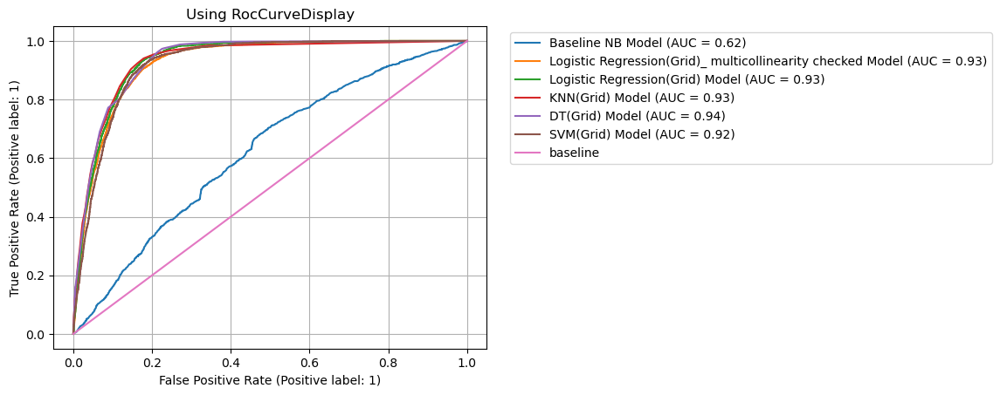

In [328]:
fig, ax = plt.subplots()
plot_roc_curve(Baseline_model, X_test, y_test,ax = ax, name = 'Baseline NB Model')
plot_roc_curve(Log_Grid_mul, X_trainmul,y_trainmul,ax = ax, name = 'Logistic Regression(Grid)_ multicollinearity checked Model')
plot_roc_curve(Log_Grid, X_test1, y_test1,ax = ax, name = 'Logistic Regression(Grid) Model')
plot_roc_curve(KNN_Grid, X_test1, y_test1,ax = ax, name = 'KNN(Grid) Model')
plot_roc_curve(DT_Grid, X_test1, y_test1,ax = ax, name = 'DT(Grid) Model')
plot_roc_curve(SVM_Grid, X_test1, y_test1,ax = ax, name = 'SVM(Grid) Model')
plt.grid()
plt.plot(np.arange(0, 1.1, .1), np.arange(0, 1.1, .1), label = 'baseline');
plt.title('Using RocCurveDisplay')
plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left");

##### Questions